# DIP Assignment 2

### Requirements :-
##### Libraries:-
* Numpy
* os
* Python 3.x
* scikit-image
* matplotlib
* math
* mpl_toolkits.axes_grid1
* time

### To run this notebook successfully, please ensure the following steps.
* Ensure that all the libraries mentioned above are installed
* Ensure that in the current working directory the folder **A2_resources** and its entire folder structure exists and is maintained. **This is the input data to notebook.**



###### Note:-
* ***If any of the steps are missing/files are missing, then some parts of the code may or may not work***
* *The Results folder contains some outputs saved from the script*

In [1]:
# Importing libraries
import numpy as np
import os
import skimage
import matplotlib
import matplotlib.pyplot as plt
from math import sqrt,exp,pi
from mpl_toolkits.axes_grid1 import make_axes_locatable
import matplotlib.cm as cm
import cv2
from time import time
from matplotlib.image import imread
plt.rcParams["figure.figsize"] = (15,15)
plt.rcParams["figure.dpi"] = 40

In [2]:
# Input data
file = os.path.join(os.getcwd(), 'A2_resources/barbara.jpg')
barbara = imread(file)
file = os.path.join(os.getcwd(), 'A2_resources/bell.jpg')
bell = imread(file)
file = os.path.join(os.getcwd(), 'A2_resources/blur.jpg')
blur = imread(file)
file = os.path.join(os.getcwd(), 'A2_resources/box.png')
box = imread(file)
file = os.path.join(os.getcwd(), 'A2_resources/Clear.jpg')
clear = imread(file)
file = os.path.join(os.getcwd(), 'A2_resources/cubes.png')
cubes = imread(file)
file = os.path.join(os.getcwd(), 'A2_resources/Degraded.jpg')
degraded = imread(file)
file = os.path.join(os.getcwd(), 'A2_resources/gt_noir.png')
gtnoir = imread(file)
file = os.path.join(os.getcwd(), 'A2_resources/gt_sky.png')
gtsky = imread(file)
file = os.path.join(os.getcwd(), 'A2_resources/noir.png')
noir = imread(file)
file = os.path.join(os.getcwd(), 'A2_resources/sky.png')
sky = imread(file)
file = os.path.join(os.getcwd(), 'A2_resources/pots_flash.jpg')
potsflash = imread(file)
file = os.path.join(os.getcwd(), 'A2_resources/pots_no_flash.jpg')
potsnoflash = imread(file)
file = os.path.join(os.getcwd(), 'A2_resources/lena.jpg')
lena = imread(file)

## *Assets*

In [3]:
# RGB to greyscale
def rgb2gray(image):
    '''
    A function that takes in input an image and returns its greyscale version
    '''
    if (len(image.shape)==2):
        return image
    elif (len(image.shape)==3):
        r = image[:,:,0]
        g = image[:,:,1]
        b = image[:,:,2]
        output = 0.2989 * r + 0.5870 * g + 0.1140 * b
        return output

In [4]:
def filter2D(image, kernel):
    '''
    '''
    image = image.astype('float32')
    if (len(image.shape)==2):
        (imr,imc) = image.shape
        (kr,kc) = kernel.shape
        padr = (kr)//2
        padc = (kc)//2
        pad_im = np.zeros([imr+kr-1,imc+kc-1])
        pad_im[0:imr, 0:imc] = image
        output = np.zeros(image.shape)
        flag = np.allclose(np.transpose(kernel), kernel)
        if (flag==1):
            for i in range(0,imr):
                for j in range(0,imc):
                    output[i,j] = np.sum(np.multiply(pad_im[i:i+kr,j:j+kc],kernel))
        else:
            for i in range(0,imr):
                for j in range(0,imc):
                    output[i,j] = np.sum(np.multiply(pad_im[i:i+kr,j:j+kc],kernel))
        
        if (kernel.sum()!=0):
            output/=kernel.sum()
            
        output = np.clip(output,0,255)
        return (output)
    
    elif (len(image.shape)==3):
        (imr,imc,ch) = image.shape
        (kr,kc) = kernel.shape
        padr = (kr)//2
        padc = (kc)//2
        pad_im = np.zeros([imr+kr-1,imc+kc-1,ch])
        pad_im[0:imr, 0:imc,ch] = image
        output = np.zeros(image.shape)
        flag = np.allclose(np.transpose(kernel), kernel)
        if (flag==1):
            for k in range(0,ch):
                for i in range(0,imr):
                    for j in range(0,imc):
                        output[i,j,k] = np.sum(np.multiply(pad_im[i:i+kr,j:j+kc,k],kernel))
#             return (output).astype('uint8')
        else:
            for k in range(0,ch):
                for i in range(0,imr):
                    for j in range(0,imc):
                        output[i,j,k] = np.sum(np.multiply(pad_im[i:i+kr,j:j+kc,k],kernel))
#             return (output).astype('uint8')
        
        if (kernel.sum()!=0):
            output/=kernel.sum()
            
        output = np.clip(output,0,255)
        return (output)

In [5]:
def medfilt(image, ksize = 3):
    '''
    '''
    output = np.zeros(image.shape)
    pad_im = np.zeros([image.shape[0]+ksize,image.shape[1]+ksize])
    pad_im[0:image.shape[0],0:image.shape[1]]=image
#     print(pad_im)
    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            output[i,j] = np.median(pad_im[i:i+ksize,j:j+ksize])     
    return output

In [6]:
def medfiltwrap(image, ksize=3):
    output = np.zeros(image.shape)
    if (len(image.shape)==2):
        output = medfilt(image,ksize)
    elif (len(image.shape)==3):
        output[:,:,0] = medfilt(image[:,:,0],ksize)
        output[:,:,1] = medfilt(image[:,:,1],ksize)
        output[:,:,2] = medfilt(image[:,:,2],ksize)
        
    return output.astype('uint8')

In [7]:
def saltpepper(image):
    row,col = image.shape
    s_vs_p = 0.5
    amount = 0.04
    out = np.copy(image)
    num_salt = np.ceil(amount * image.size * s_vs_p)
    coords = [np.random.randint(0, i - 1, int(num_salt))for i in image.shape]
    out[coords] = np.amax(image)
    num_pepper = np.ceil(amount* image.size * (1. - s_vs_p))
    coords = [np.random.randint(0, i - 1, int(num_pepper))for i in image.shape]
    out[coords] = 0
    return out

/home/soumyasis/.virtualenvs/cvit1/lib/python3.6/site-packages/ipykernel_launcher.py:8: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  
/home/soumyasis/.virtualenvs/cvit1/lib/python3.6/site-packages/ipykernel_launcher.py:11: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  # This is added back by InteractiveShellApp.init_path()


Text(0.5, 1.0, 'Image with salt pepper noise')

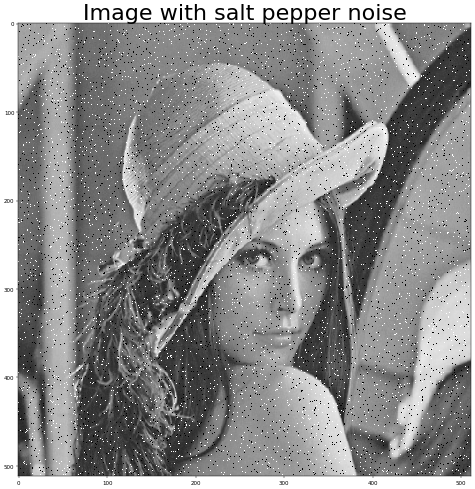

In [72]:
splena = saltpepper(rgb2gray(lena))
plt.figure(figsize = [15,15], dpi = 40)
plt.imshow(splena.astype('uint8'),'gray')
plt.title('Image with salt pepper noise',fontsize = 40)

## Question 1

**Part - 1**  *Apply the Canny edge detector(use cv2.Canny or MATLAB’s edge function) to
bell.jpg and cubes.png. Tweak the values of the arguments(minVal and maxVal),
and report the values that give the best results for each image. Hint: For the bell
image, try to detect as many edges in the bell as possible, while avoiding edges in
the background.*

Text(0.5, 1.0, 'Edges detected using \n Canny Detection on cubes.png')

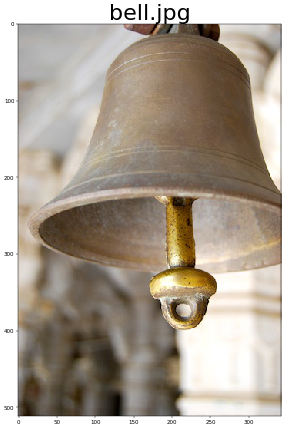

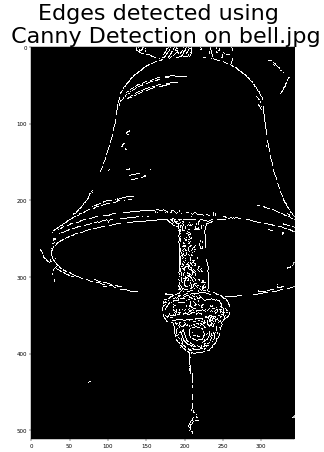

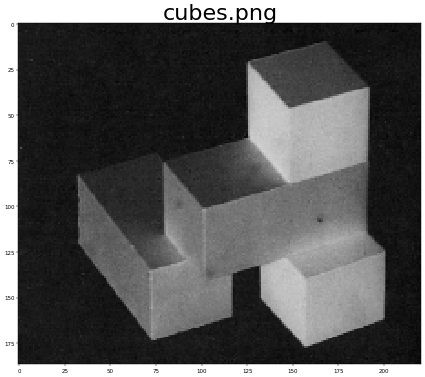

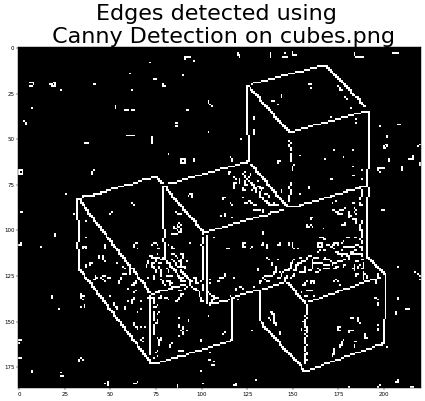

In [9]:
bell_Canny = cv2.Canny(bell, 100, 160)
cubes_Canny = cv2.Canny((cubes*255).astype('uint8'), 50, 60)

plt.figure(figsize = [13,13], dpi=40)
plt.imshow(bell)
plt.title('bell.jpg',fontsize = 40)
plt.figure(figsize = [13,13], dpi=40)
plt.imshow(bell_Canny, cmap = 'gray')
plt.title('Edges detected using \n Canny Detection on bell.jpg',fontsize=40)

plt.figure(figsize = [13,13], dpi=40)
plt.imshow(cubes)
plt.title('cubes.png',fontsize = 40)
plt.figure(figsize = [13,13], dpi=40)
plt.imshow(cubes_Canny, cmap = 'gray')
plt.title('Edges detected using \n Canny Detection on cubes.png',fontsize=40)

**Part - 2**  *Consider Roberts, Prewitt, and Sobel filters and Laplacian filters. Apply these filters on barbara.jpg and make observations upon comparing their outputs. Compare these with the output of Canny edge detector on the same image.*

Text(0.5, 1.0, 'Canny')

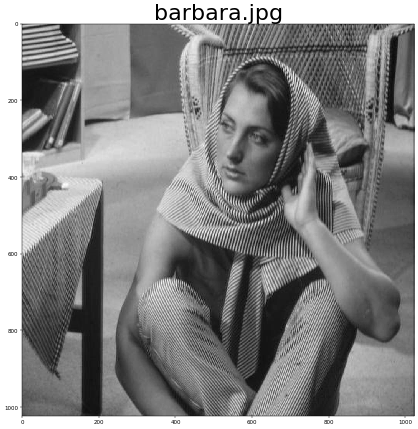

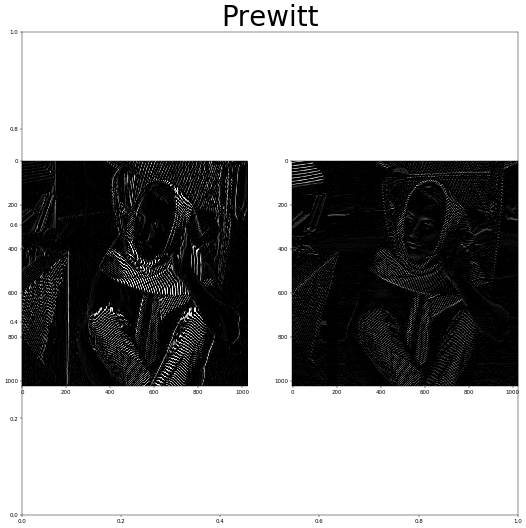

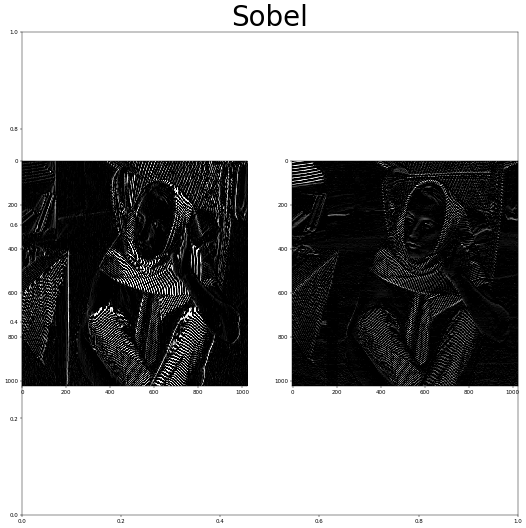

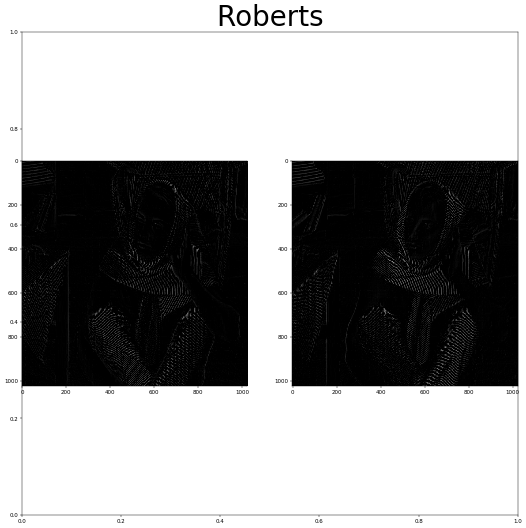

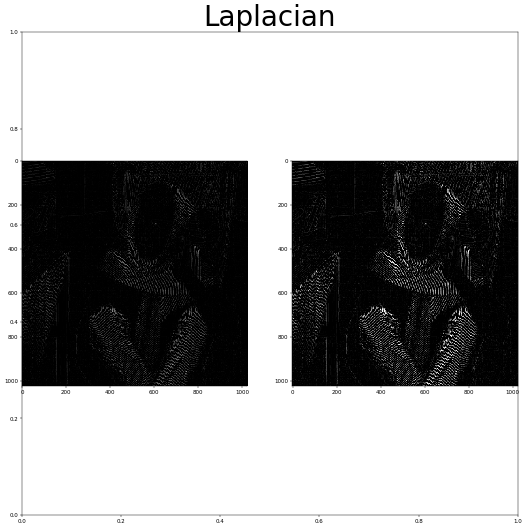

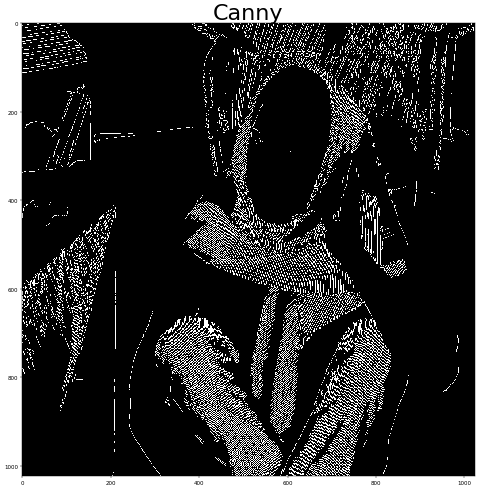

In [10]:
prewitt_mx = np.array([[-1,0,1],[-1,0,1],[-1,0,1]])
prewitt_my = np.array([[1,1,1],[0,0,0],[-1,-1,-1]])

sobel_mx = np.array([[-1,0,1],[-2,0,2],[-1,0,1]])
sobel_my = np.array([[1,2,1],[0,0,0],[-1,-2,-1]])

roberts_mx = np.array([[0,1],[-1,0]])
roberts_my = np.array([[1,0],[0,-1]])

laplacian1 = np.array([[0,1,0],[1,-4,1],[0,1,0]])
laplacian2 = np.array([[1,1,1],[1,-8,1],[1,1,1]])

img_prew_x = filter2D(barbara, prewitt_mx)
img_prew_y = filter2D(barbara, prewitt_my)


img_sobel_x = filter2D(barbara, sobel_mx)
img_sobel_y = filter2D(barbara, sobel_my)

img_rob_x = filter2D(barbara, roberts_mx)
img_rob_y = filter2D(barbara, roberts_my)


img_lap1 = filter2D(barbara, laplacian1)
img_lap2 = filter2D(barbara, laplacian2)

img_canny = cv2.Canny(rgb2gray(barbara), 100,200)

plt.figure(figsize = [13,13], dpi=40)
plt.imshow(barbara, cmap='gray')
plt.title('barbara.jpg',fontsize = 40)

fig1 = plt.figure(figsize = [16,16], dpi=40)
plt.title('Prewitt',fontsize='50')
ax1 = fig1.add_subplot(121)
ax1.imshow(img_prew_x, cmap='gray')
ax2 = fig1.add_subplot(122)
ax2.imshow(img_prew_y, cmap='gray')

fig2 = plt.figure(figsize = [16,16], dpi=40)
plt.title('Sobel',fontsize='50')
ax3 = fig2.add_subplot(121)
ax3.imshow(img_sobel_x, cmap='gray')
ax4 = fig2.add_subplot(122)
ax4.imshow(img_sobel_y, cmap='gray')

fig3 = plt.figure(figsize = [16,16], dpi=40)
plt.title('Roberts',fontsize='50')
ax5 = fig3.add_subplot(121)
ax5.imshow(img_rob_x, cmap='gray')
ax6 = fig3.add_subplot(122)
ax6.imshow(img_rob_y, cmap='gray')

fig4 = plt.figure(figsize = [16,16], dpi=40)
plt.title('Laplacian',fontsize='50')
ax7 = fig4.add_subplot(121)
ax7.imshow(img_lap1, cmap='gray')
ax8 = fig4.add_subplot(122)
ax8.imshow(img_lap2, cmap='gray')

plt.figure(figsize = [15,15], dpi=40)
plt.imshow(img_canny, cmap = 'gray')
plt.title('Canny', fontsize = 40)

**Part - 3**  *Add noise to the input image above using Gaussian sampling. Study the effect of
applying the filters on noise-affected inputs.*

Text(0.5, 1.0, 'Canny')

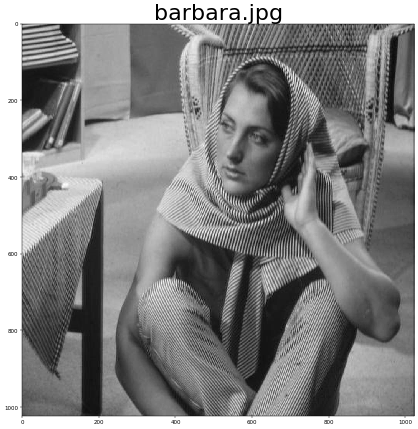

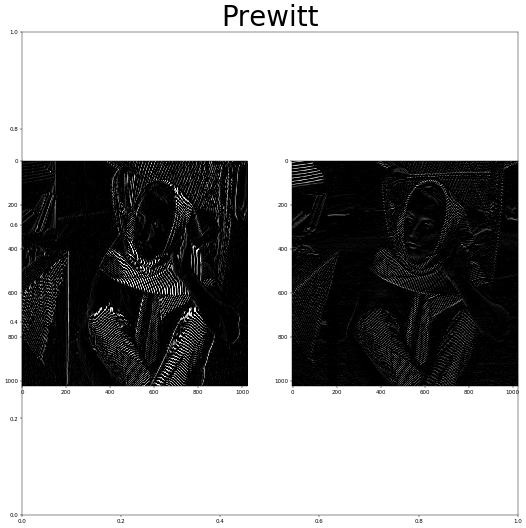

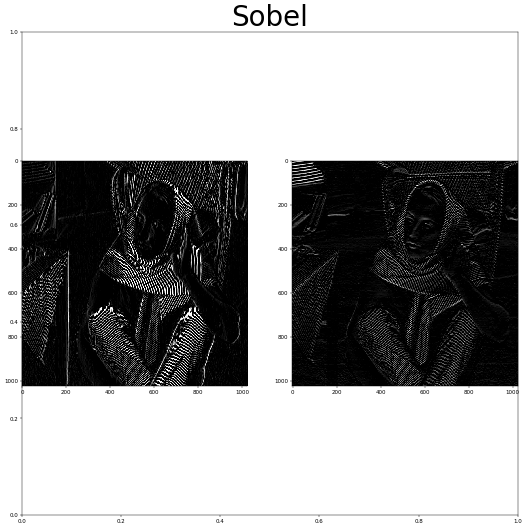

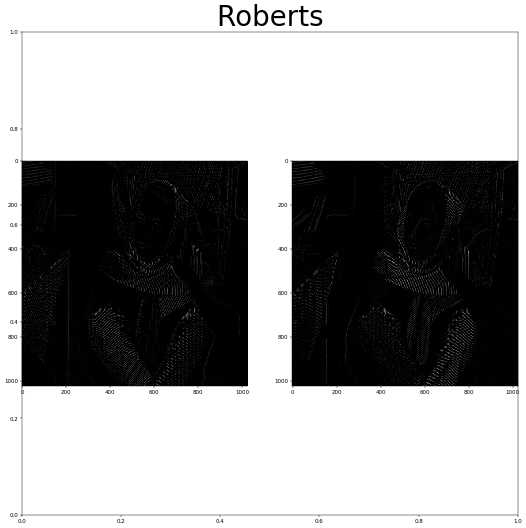

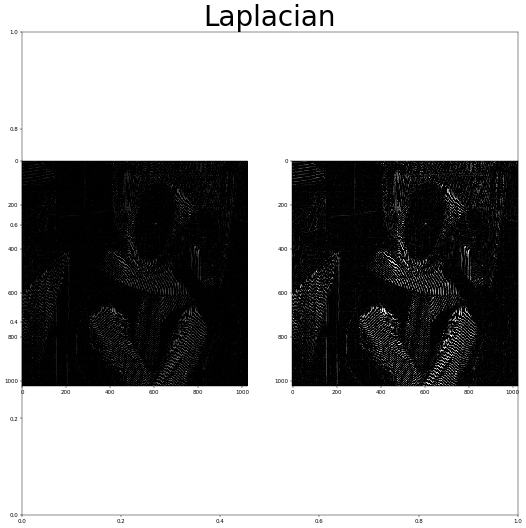

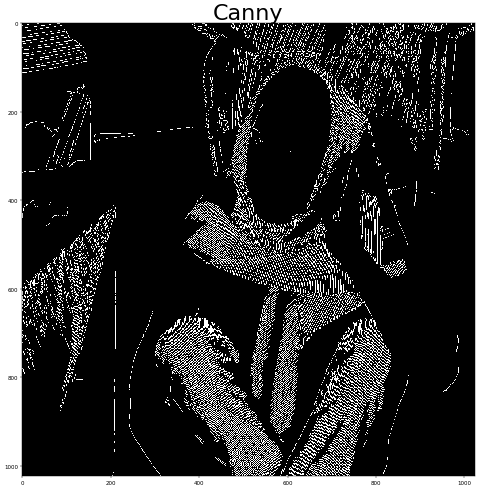

In [11]:
mean = 0
var = 0.1
stddev = var**0.5
gauss_noise = np.random.normal(mean, stddev, (barbara.shape)).reshape(barbara.shape)

noisy_barbara = barbara+gauss_noise
img_prew_x_noisy = filter2D(noisy_barbara, prewitt_mx)
img_prew_y_noisy = filter2D(noisy_barbara, prewitt_my)

img_sobel_x_noisy = filter2D(noisy_barbara, sobel_mx)
img_sobel_y_noisy = filter2D(noisy_barbara, sobel_my)

img_rob_x_noisy = filter2D(noisy_barbara, roberts_mx)
img_rob_y_noisy = filter2D(noisy_barbara, roberts_my)

img_lap1_noisy = filter2D(noisy_barbara, laplacian1)
img_lap2_noisy = filter2D(noisy_barbara, laplacian2)

img_canny_noisy = cv2.Canny((noisy_barbara).astype('uint8'), 100,200)

plt.figure(figsize = [13,13], dpi=40)
plt.imshow(barbara, cmap='gray')
plt.title('barbara.jpg',fontsize = 40)

fig1 = plt.figure(figsize = [16,16], dpi=40)
plt.title('Prewitt',fontsize='50')
ax1 = fig1.add_subplot(121)
ax1.imshow(img_prew_x_noisy.astype('uint8'), cmap='gray')
ax2 = fig1.add_subplot(122)
ax2.imshow(img_prew_y_noisy.astype('uint8'), cmap='gray')

fig2 = plt.figure(figsize = [16,16], dpi=40)
plt.title('Sobel',fontsize='50')
ax3 = fig2.add_subplot(121)
ax3.imshow(img_sobel_x_noisy.astype('uint8'), cmap='gray')
ax4 = fig2.add_subplot(122)
ax4.imshow(img_sobel_y_noisy.astype('uint8'), cmap='gray')

fig3 = plt.figure(figsize = [16,16], dpi=40)
plt.title('Roberts',fontsize='50')
ax5 = fig3.add_subplot(121)
ax5.imshow(img_rob_x_noisy.astype('uint8'), cmap='gray')
ax6 = fig3.add_subplot(122)
ax6.imshow(img_rob_y_noisy.astype('uint8'), cmap='gray')

fig4 = plt.figure(figsize = [16,16], dpi=40)
plt.title('Laplacian',fontsize='50')
ax7 = fig4.add_subplot(121)
ax7.imshow(img_lap1_noisy.astype('uint8'), cmap='gray')
ax8 = fig4.add_subplot(122)
ax8.imshow(img_lap2_noisy.astype('uint8'), cmap='gray')

plt.figure(figsize = [15,15], dpi=40)
plt.imshow(img_canny, cmap = 'gray')
plt.title('Canny', fontsize = 40)

### The effect of applying filters on noisy images are :-

* We can see the formation of some false edges
* In some cases where the filters are direction sensitive, if we have edges that have become curved due to noise, we can see their appearance in both directions
*  In the noisy image, finding the edge is very difficult because both edge and noise contain high frequency. 

## Question 2

*Prove that subtracting the Laplacian from an image is proportional to un-
sharp masking.*

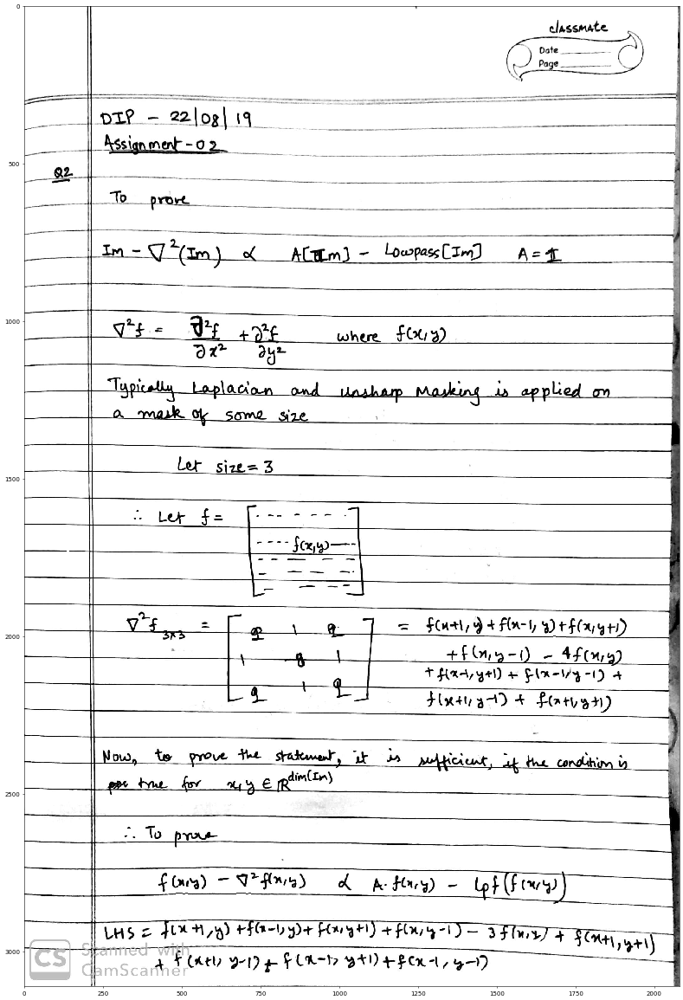

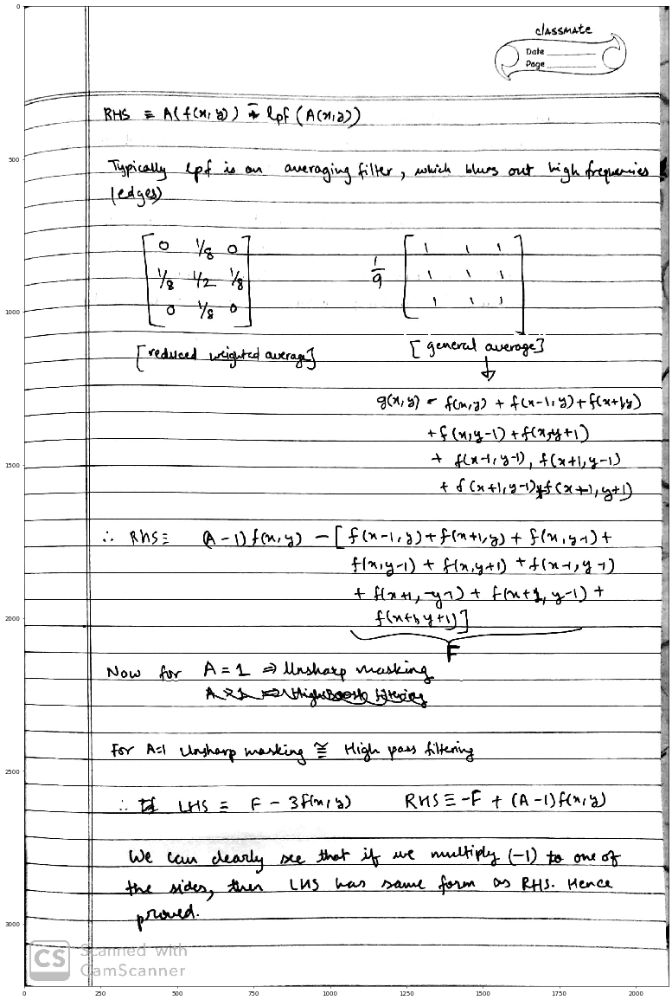

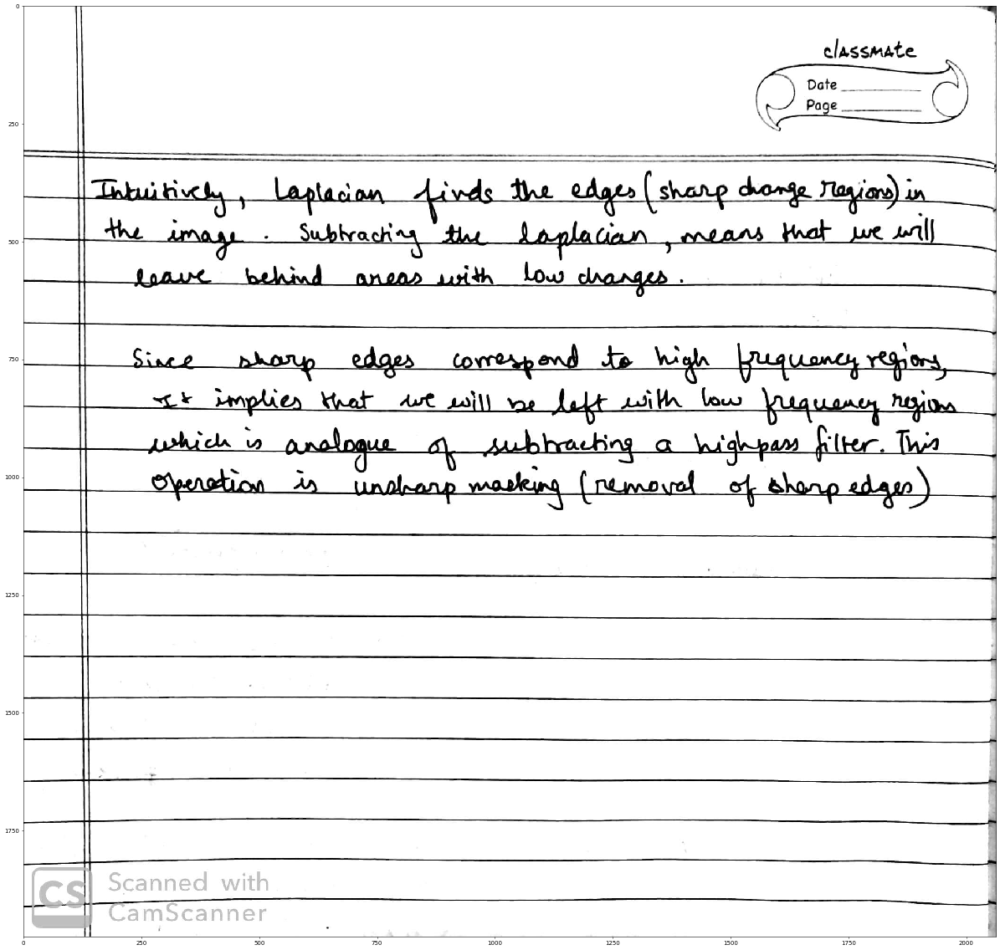

In [12]:
file = os.path.join(os.getcwd(), 'A2_resources/q2im1.jpg')
q2im1 = imread(file)
file = os.path.join(os.getcwd(), 'A2_resources/q2im2.jpg')
q2im2 = imread(file)
file = os.path.join(os.getcwd(), 'A2_resources/q2im3.jpg')
q2im3 = imread(file)

plt.figure(figsize = [30,30], dpi = 50)
plt.imshow(q2im1)
plt.figure(figsize = [30,30], dpi = 50)
plt.imshow(q2im2)
plt.figure(figsize = [30,30], dpi = 50)
plt.imshow(q2im3)

## Question 3

**Part - 1** *Create a matrix of size 3x3 which when convolved with box.png results
in a white line where the white meets the black.*

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(0.5, 1.0, 'Sobel of box.png in y dimension')

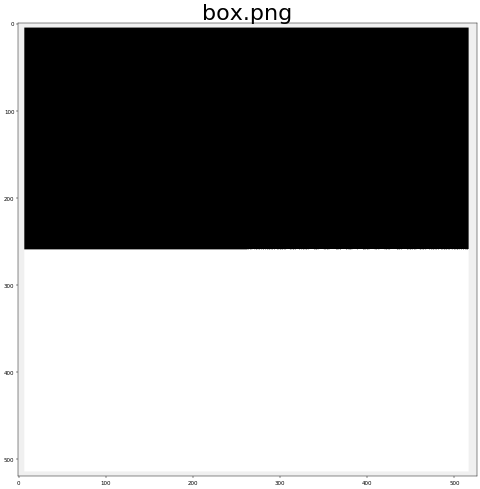

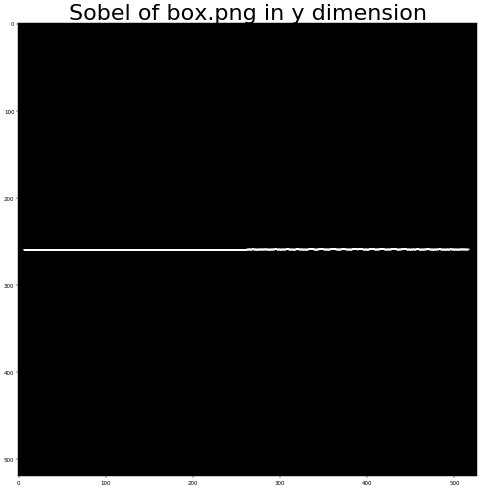

In [13]:
white_edge_kernel = np.array([[-1,-2,-1],[0,0,0],[1,2,1]])
dbox_by_dy = cv2.filter2D(box, -1, white_edge_kernel)

plt.figure(figsize=[15,15], dpi=40)
plt.imshow(box)
plt.title('box.png',fontsize=40)

plt.figure(figsize=[15,15], dpi=40)
plt.imshow(dbox_by_dy, cmap = 'gray')
plt.title('Sobel of box.png in y dimension',fontsize=40)

**Part - 2** *Convolve blur.jpg with the above matrix and the transpose of the above matrix.
Report your observations.*

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(0.5, 1.0, 'Applying kernel on \n blur.jpg in x dimension')

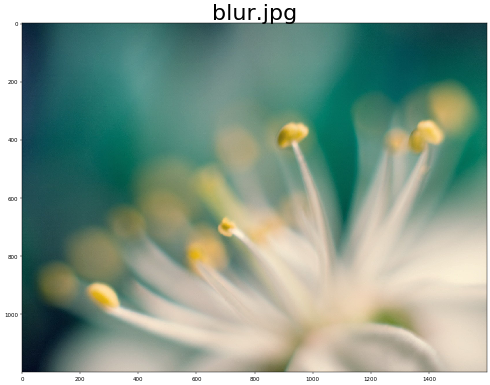

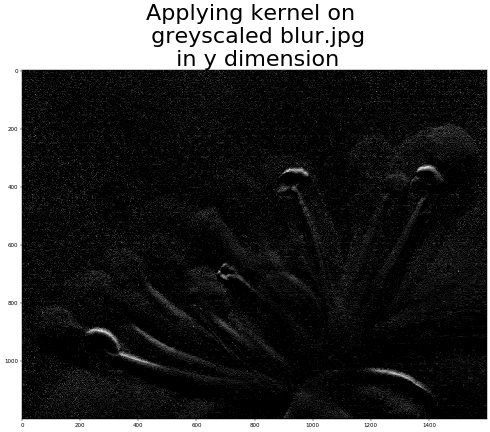

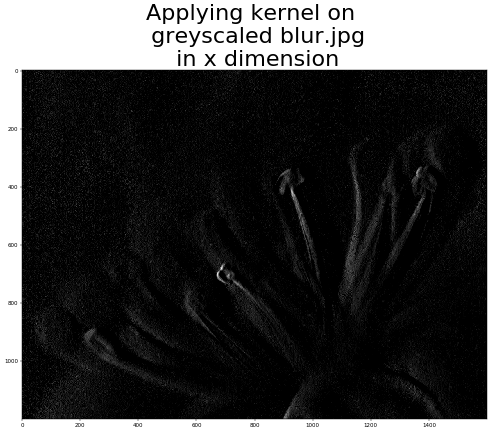

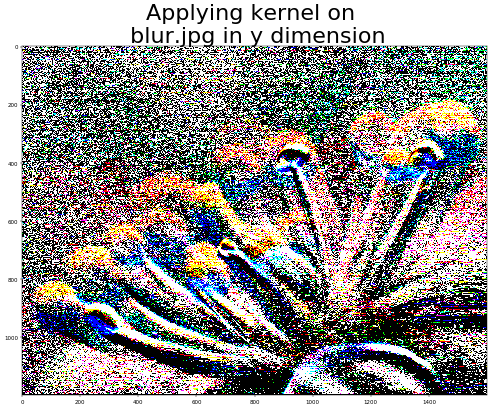

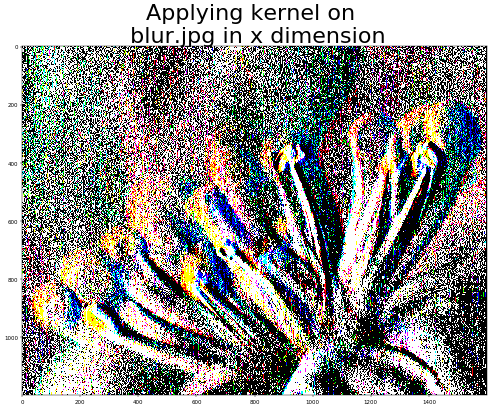

In [14]:
dblur_by_dy = np.zeros(blur.shape)
dblur_by_dx = np.zeros(blur.shape)
dblur_by_dy[:,:,0] = filter2D(blur[:,:,0],white_edge_kernel)
dblur_by_dy[:,:,1] = filter2D(blur[:,:,1],white_edge_kernel)
dblur_by_dy[:,:,2] = filter2D(blur[:,:,2],white_edge_kernel)
dblur_by_dx[:,:,0] = filter2D(blur[:,:,0],np.transpose(white_edge_kernel))
dblur_by_dx[:,:,1] = filter2D(blur[:,:,1],np.transpose(white_edge_kernel))
dblur_by_dx[:,:,2] = filter2D(blur[:,:,2],np.transpose(white_edge_kernel))

plt.figure(figsize=[15,15], dpi=40)
plt.imshow(blur)
plt.title('blur.jpg',fontsize=40)

plt.figure(figsize=[15,15], dpi=40)
plt.imshow(filter2D(rgb2gray(blur),white_edge_kernel),cmap='gray')
plt.title('Applying kernel on \n greyscaled blur.jpg\n in y dimension',fontsize=40)

plt.figure(figsize=[15,15], dpi=40)
plt.imshow(filter2D(rgb2gray(blur),np.transpose(white_edge_kernel)),cmap='gray')
plt.title('Applying kernel on \n greyscaled blur.jpg\n in x dimension',fontsize=40)

plt.figure(figsize=[15,15], dpi=40)
plt.imshow(dblur_by_dy)
plt.title('Applying kernel on \n blur.jpg in y dimension',fontsize=40)

plt.figure(figsize=[15,15], dpi=40)
plt.imshow(dblur_by_dx)
plt.title('Applying kernel on \n blur.jpg in x dimension',fontsize=40)

### Observations
* Some regions that have blurred petals, give noisy edges. 
* This is because of slow changes in pixel which arise due to blurring
* If we run on separate channels of rgb image, the edges are noisy and there is generation of falsely coloured zones
* This is due to the fact that intensity maps of the picture are different at different regions. So an edge detected in a channel, may not correspond to an edge in another channel, leading to false colour

**Part - 3** *Follow the above steps for suitable images of your choice.*



Text(0.5, 1.0, 'Applying kernel on \n valve.png in y dimension')

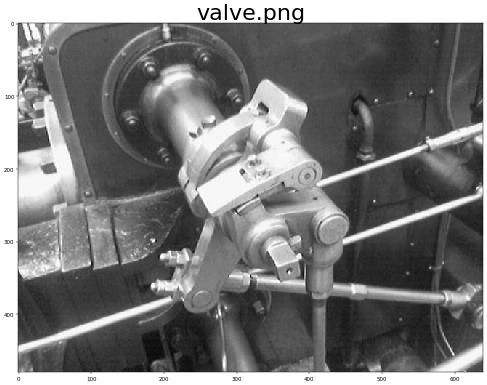

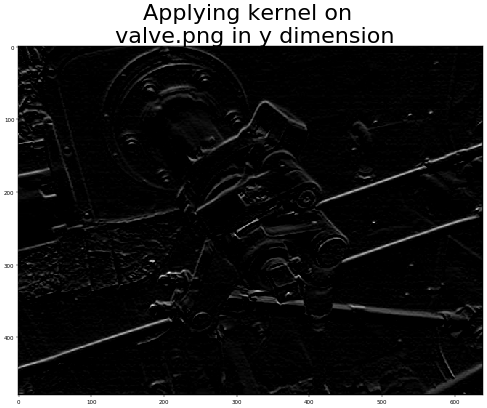

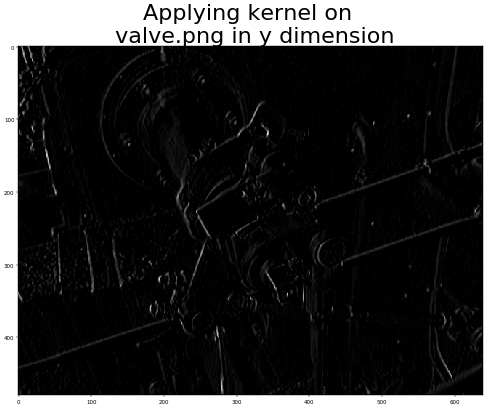

In [18]:
file = os.path.join(os.getcwd(), 'A2_resources/valve.png')
valve = imread(file)
# valve = ((valve-np.amin(valve))/(np.amax(valve)-np.amin(valve))*255).astype('uint8')

dblur_by_dy = filter2D(rgb2gray(blur),white_edge_kernel)
dblur_by_dx = filter2D(rgb2gray(blur),np.transpose(white_edge_kernel))
dvalve_by_dy = filter2D(rgb2gray(valve),white_edge_kernel)
dvalve_by_dx = filter2D(rgb2gray(valve),np.transpose(white_edge_kernel))

plt.figure(figsize=[15,15], dpi=40)
plt.imshow(rgb2gray(valve), cmap='gray')
plt.title('valve.png',fontsize=40)

plt.figure(figsize=[15,15], dpi=40)
plt.imshow(dvalve_by_dy, cmap='gray')
plt.title('Applying kernel on \n valve.png in y dimension',fontsize=40)

plt.figure(figsize=[15,15], dpi=40)
plt.imshow(dvalve_by_dx, cmap = 'gray')
plt.title('Applying kernel on \n valve.png in y dimension',fontsize=40)

## Question 4

**Part - 1** *Implement high-boost filtering on the image bell.jpg varying the window size and
the weight factor and report your observations.*

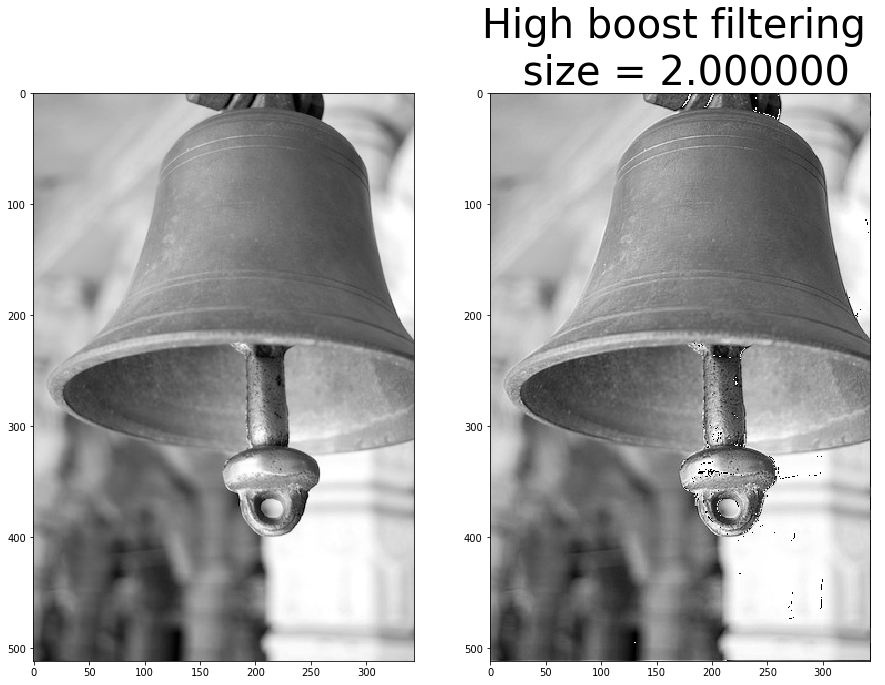

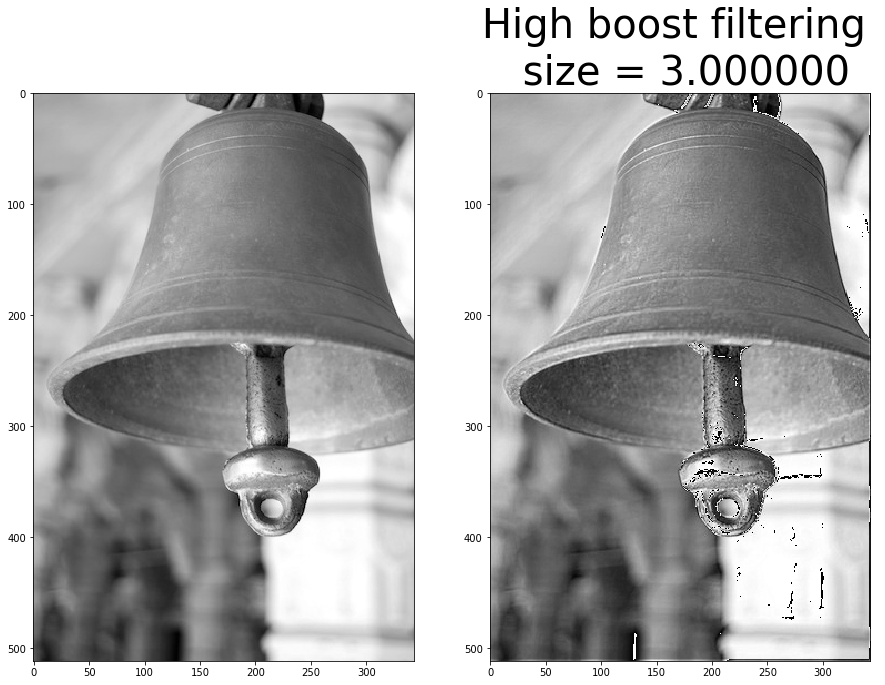

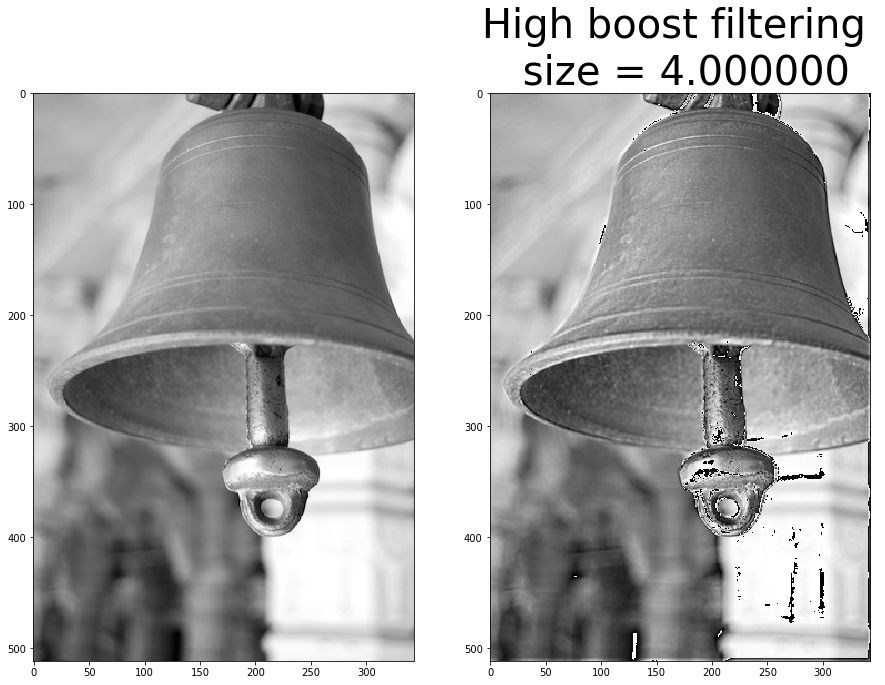

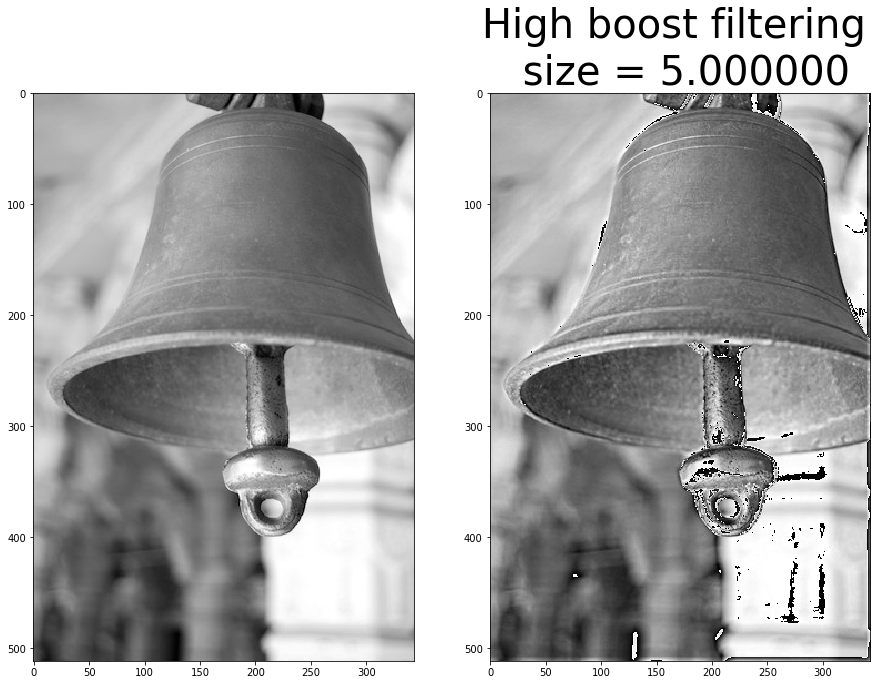

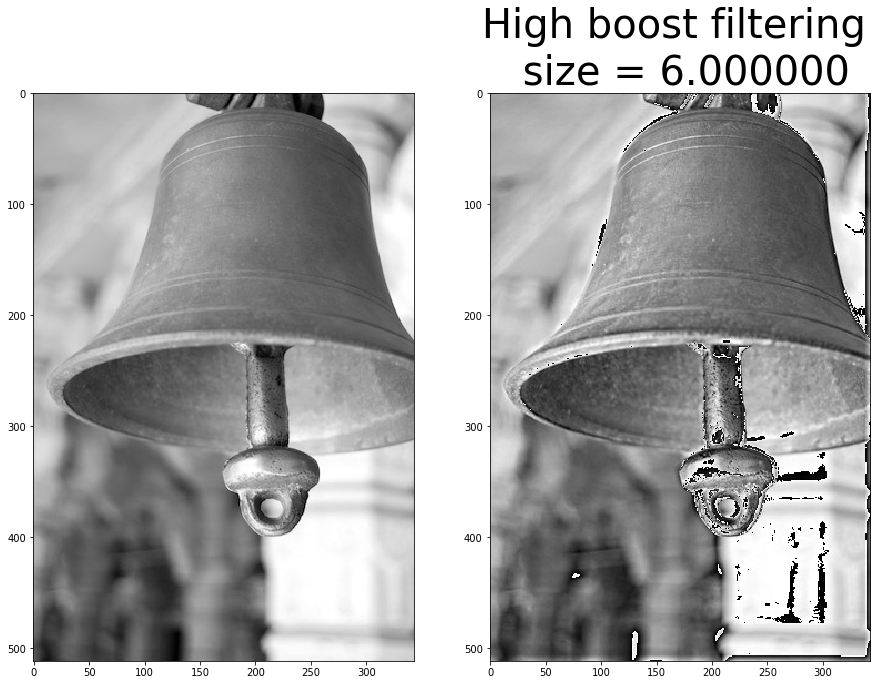

In [19]:
# for i in range(out.shape[0]):
#     for j in range(out.shape[1]):
#         if out[i][j]>255:
#             out[i][j]=255
#         elif out[i][j]<0:
#             out[i][j]=0
                    
A = 2
for size in range(2,7):
    lowpass_bell = (filter2D(rgb2gray(bell), np.ones([size,size])/(size**2)).astype('uint8'))
    bell_highboost = (A*rgb2gray(bell) - lowpass_bell).astype('uint8')
    plt.figure(figsize=[15,15])
    plt.subplot(121)
    plt.imshow(rgb2gray(bell),cmap = 'gray')
    plt.subplot(122)
    plt.imshow(np.clip(bell_highboost,0,255), cmap = 'gray')
    plt.title('High boost filtering \n size = %f'%size, fontsize=40)

**Part 2** *Repeat the above exercise on suitable images of your choice.*

Text(0.5, 1.0, 'Highboosted Image')

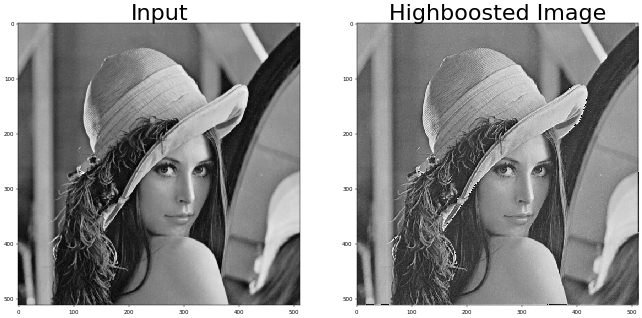

In [20]:
size = 2
A = 2

lowpass_lena = (filter2D(rgb2gray(lena), np.ones([size,size])/(size**2)).astype('uint8'))
lena_highboost = (A*rgb2gray(lena) - lowpass_lena).astype('uint8')

plt.figure(figsize=[20,20], dpi=40)
plt.subplot(121)
plt.imshow(rgb2gray(lena),cmap = 'gray')
plt.title('Input', fontsize=40)
# plt.figure(figsize=[15,15], dpi=40)
# plt.imshow((lowpass_bell), cmap = 'gray')

plt.subplot(122)
plt.imshow(np.clip(lena_highboost,0,255), cmap = 'gray')
plt.title('Highboosted Image', fontsize = 40)

**Part 3** *How is bilateral filtering different from high-boost filtering?*

>**Bilateral Filtering** :-
        * Bilateral filtering is applying gaussian smoothening on regions without sharp changes. Hence we preserve `high frequency components` and introduce `low frequency components`
    * Bilateral filtering is partially *`content-aware`*, meaning that the processing of filters depends upon pixel values(edge information) in different spatial locations.
    * Being content-aware, image looks more natural with enhanced edges.

>**High Boost Filtering** :-
    * High boost filtering is amplifying high frequencies in image by amplifying the original image and then removing the low frequency zones of image
    * As a result, image edges acquire "sketch-pen effect". The edges look sharper than natural.

## Question 5

*The implementation of linear spatial filters requires moving a mask cen-
tered at each pixel of the image, computing sum of products of mask coefficients and
corresponding pixels.*

**Part 1** *Implement an algorithm for low-pass filtering a grayscale image by moving a k × k
averaging filter of the form ones(k)/(k^2 ).*

In [21]:
def lowpass(image,k):
    output = (filter2D(rgb2gray(image),  np.ones([k,k])/(k**2)).astype('uint8'))
    return (output)

Text(0.5, 1.0, 'Lowpass Image')

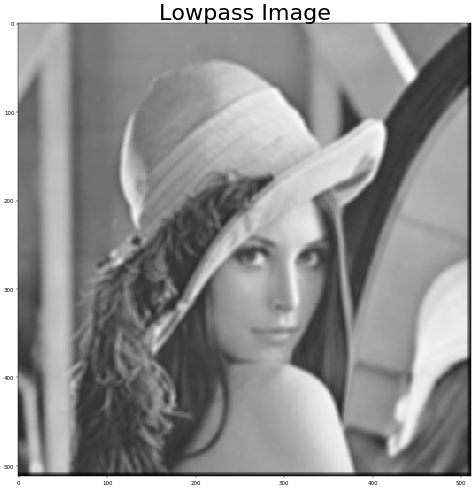

In [22]:
output_lowpass = lowpass(rgb2gray(lena), 6)
plt.figure(figsize=[15,15], dpi=40)
plt.imshow(output_lowpass.astype('uint8'),cmap='gray')
plt.title('Lowpass Image', fontsize=40)

**Part - 2** *As the filter is moved from one spatial location to the next one, the filter window
shares many common pixels in adjacent neighborhoods. Exploit this observation
and implement a more efficient version of averaging filter. To appreciate the benefits
of doing so, generate a plot of k vs run-time for various sized images. The plot
diagram should contain a line plot for each image size you pick. Use different marker
types to distinguish the default implementation and improved implementation. Just
to give you a rough idea, look at https://imgur.com/a/0HtYlTE.*

In [23]:
def optavg(image, ksize=3):
    '''
    '''
    output = np.zeros(image.shape)
    pad_im = np.zeros([image.shape[0]+ksize-1,image.shape[1]+ksize-1])
    pad_im[0:image.shape[0],0:image.shape[1]] = image
    cum_row = np.zeros(pad_im.shape)
    denom = ksize**2
    for i in range(0,image.shape[0]):
        for j in range(0,image.shape[1]):
            if(j==0):
                cum_row[i,j] = pad_im[i,j:j+ksize].sum()
            else:
                cum_row[i,j]+=cum_row[i,j-1]+(pad_im[i,j+ksize-1]-pad_im[i,j-1])
    
    for i in range(0,image.shape[0]):
        for j in range(0,image.shape[1]):
            if(i==0):
                output[i,j] = cum_row[i:i+ksize,j].sum()
            else:
                output[i,j]+=output[i-1,j]+(cum_row[i+ksize-1,j]-cum_row[i-1,j])
    return output/denom

Text(0.5, 1.0, 'Using optimised filter')

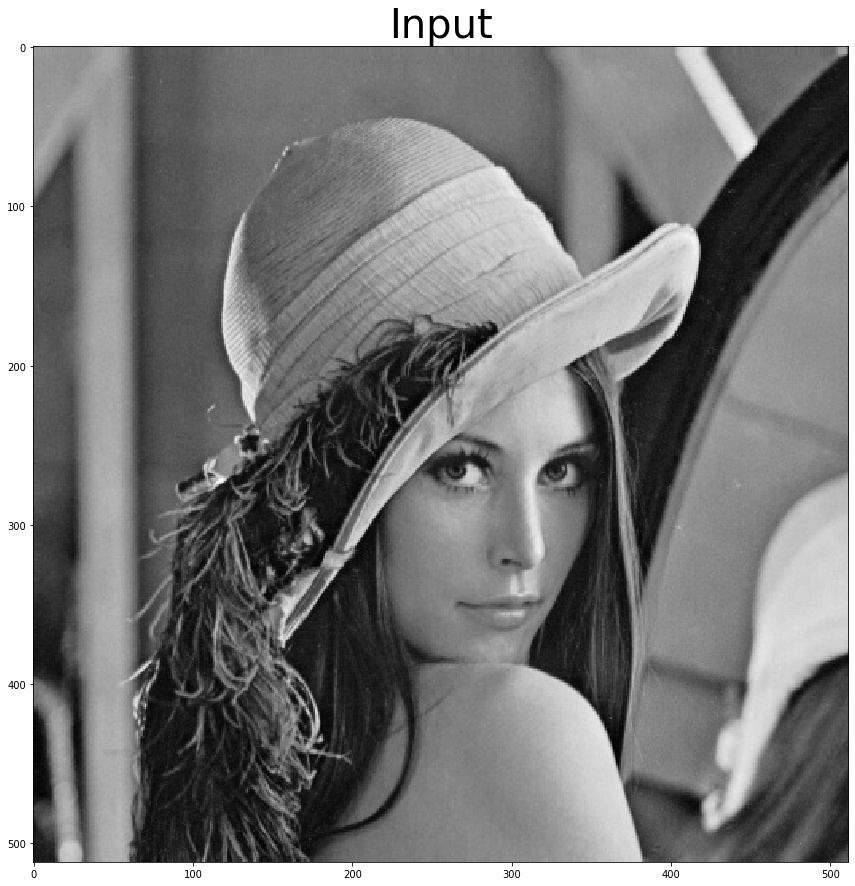

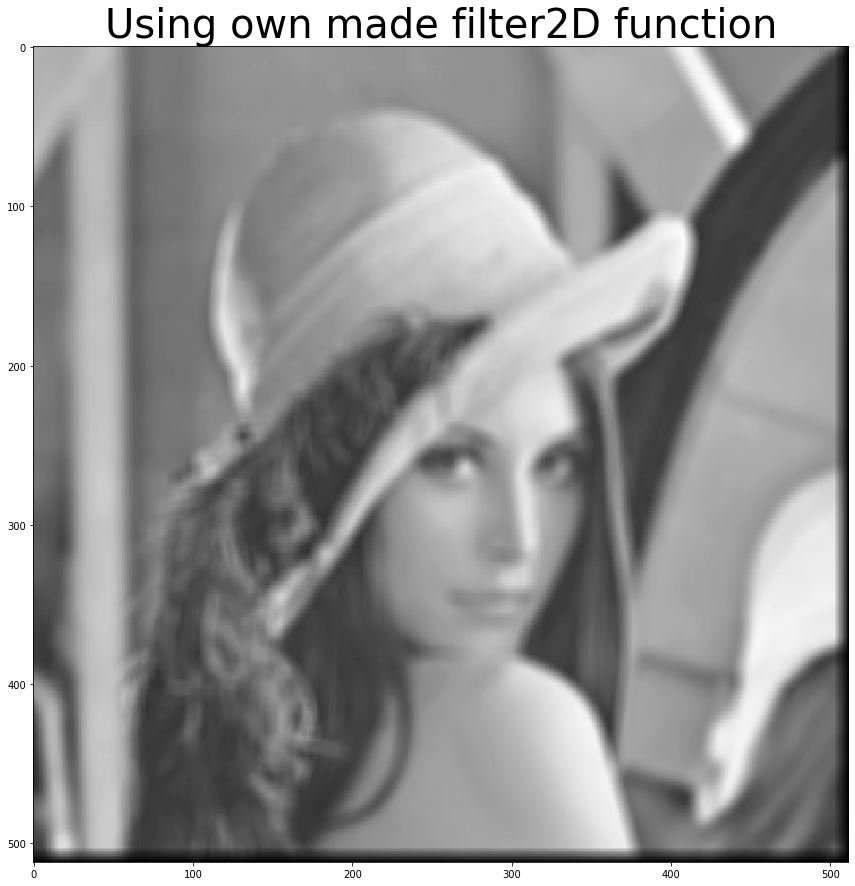

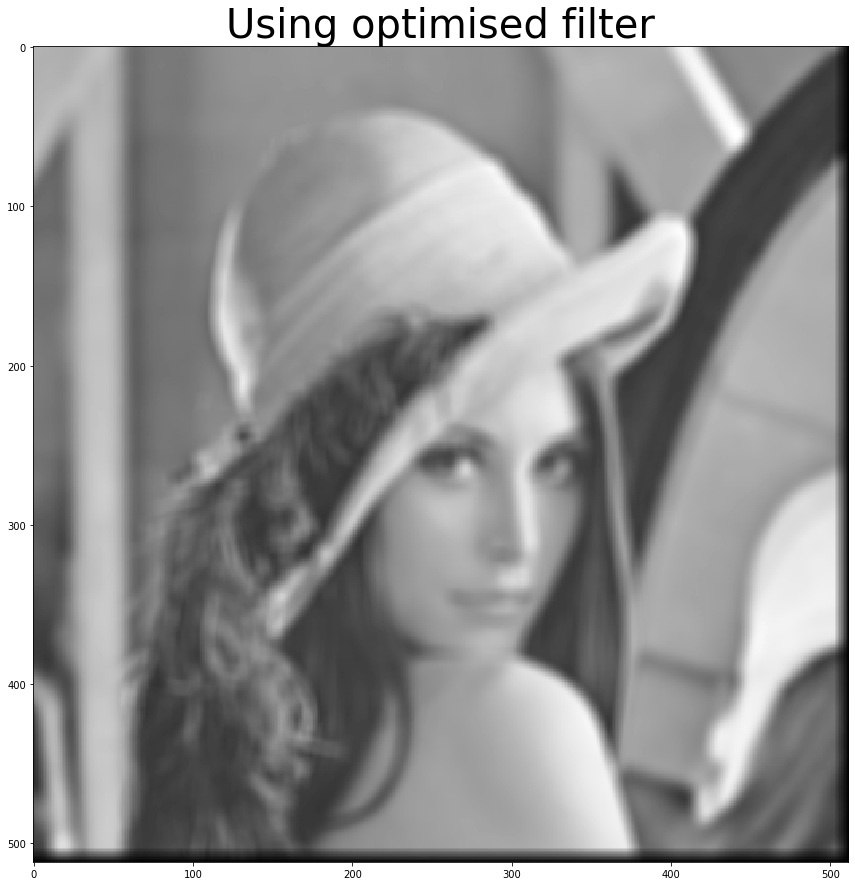

In [27]:
ksize=10
kernel =  np.ones([ksize,ksize])
input_im = rgb2gray(lena)

out_filt2D = lowpass(input_im,ksize)
out_opt = optavg(input_im, ksize)

plt.figure(figsize = [15,15])
plt.imshow(input_im,cmap='gray')
plt.title('Input', fontsize=40)

plt.figure(figsize = [15,15])
plt.imshow(out_filt2D,cmap='gray')
plt.title('Using own made filter2D function', fontsize=40)

plt.figure(figsize = [15,15])
plt.imshow(out_opt,cmap='gray')
plt.title('Using optimised filter', fontsize=40)

In [28]:
maxk = 21
time_out_filt2D = np.zeros(np.arange(2,maxk).shape)
input_im = rgb2gray(lena)

for i in range(2,maxk):
    ksize = i
    start_filt2D = time()
    out_filt2D = lowpass(input_im,ksize)
    time_out_filt2D[i-2] = (time()-start_filt2D)

In [29]:
maxk = 21
time_out_opt = np.zeros(np.arange(2,maxk).shape)
input_im = rgb2gray(lena)

for i in range(2,maxk):
    ksize = i
    start_opt = time()
    out_opt = optavg(input_im, ksize)
    time_out_opt[i-2] = (time()-start_opt)
    

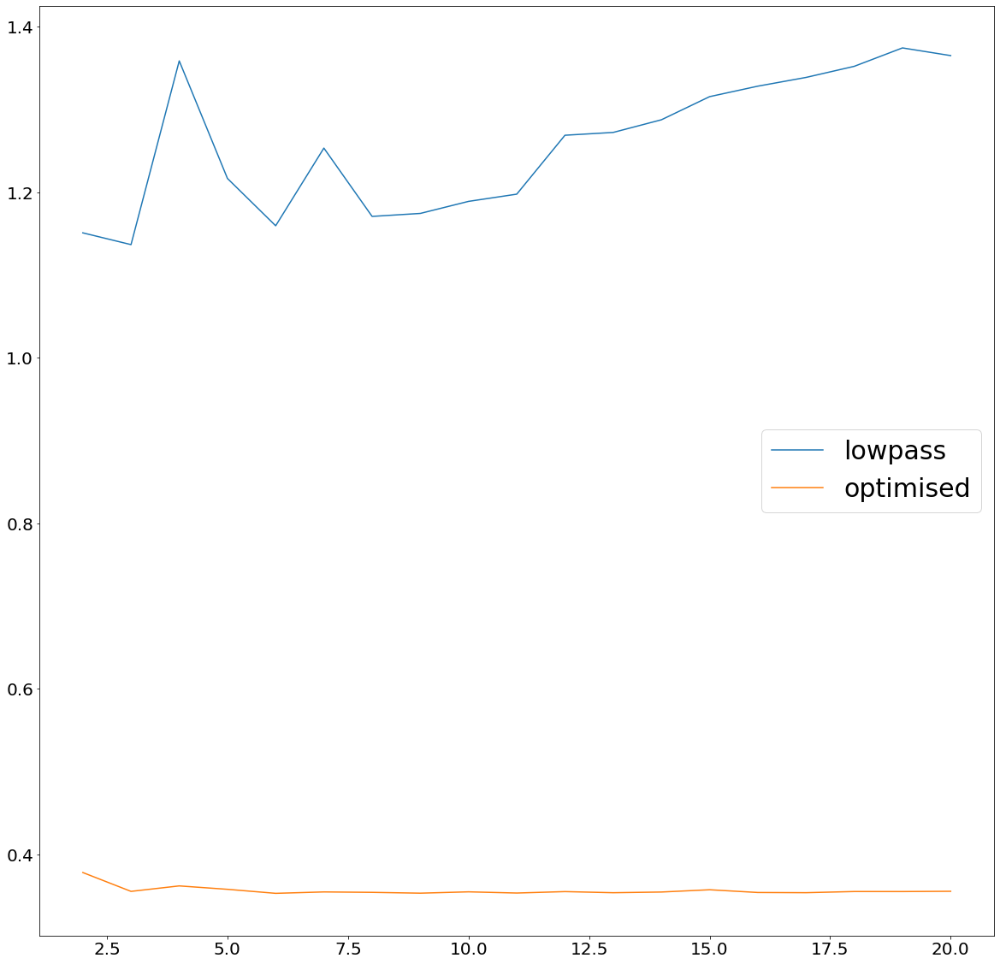

In [30]:
fig = plt.figure(figsize=[20,20])
ax= fig.add_subplot(111)
ax.tick_params(axis='both', which='major', labelsize=20)
ax.tick_params(axis='both', which='minor', labelsize=50)
ax.plot(range(2,maxk,1),time_out_filt2D,label = 'lowpass')
ax.plot(range(2,maxk,1),time_out_opt, label = 'optimised')
ax.legend(prop={'size': 30})

**Part - 3** *Utilize the observation similar to above to implement an efficient version of a k × k
median filter. Generate a plot figure similar to previous question.*

In [31]:
def medopt(image, ksize=3):
    '''
    '''
    maxInt = np.amax(image)
    output = np.zeros(image.shape)
    pad_im = np.zeros([image.shape[0]+ksize-1,image.shape[1]+ksize-1])
    pad_im[0:image.shape[0],0:image.shape[1]] = image
    ks2 = (ksize**2)
    if (ksize%2 == 0):
        medloc = (ks2/2 + (ks2 - 1)/2)/2
    else:
        medloc = (ks2-1)/2
    medloc+=1

    for i in range(image.shape[0]):
        freq = np.zeros([1,maxInt+1])
        for j in range(image.shape[1]):
            if (j == 0):
                roi = np.ravel(pad_im[i:i+ksize, j:j+ksize]).astype('int64')
                
                for x in range(len(roi)):
                    freq[0,roi[x]]+=1
                freq_cum = np.cumsum(freq)
                
                median = 0
                
                for x in range(maxInt+1):
                    if freq_cum[x]>=medloc:
                        median = x
                        break
                output[i,j] = median
                
            
            else:

                old_roi = np.ravel(pad_im[i:i+ksize,j-1]).astype('int64')
                new_roi = np.ravel(pad_im[i:i+ksize,j+ksize-1]).astype('int64')
                
                for x in range(len(old_roi)):
                    freq[0,old_roi[x]]-=1
                    freq[0,new_roi[x]]+=1
                
                freq[freq<0]=0
                freq[freq>maxInt]=maxInt
                
                freq_cum = np.cumsum(freq)
                

                output[i,j] = np.searchsorted(freq_cum,medloc)
    return output

In [32]:
def optmedfiltwrap(image, ksize=3):
    output = np.zeros(image.shape)
    if (len(image.shape)==2):
        output = medopt(image,ksize)
    elif (len(image.shape)==3):
        output[:,:,0] = medopt(image[:,:,0],ksize)
        output[:,:,1] = medopt(image[:,:,1],ksize)
        output[:,:,2] = medopt(image[:,:,2],ksize)
        
    return output.astype('uint8')

In [33]:
output = optmedfiltwrap(degraded)

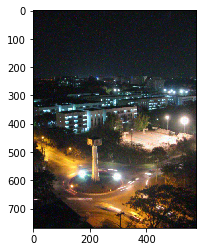

In [34]:
plt.imshow(output)

In [35]:
outputlena = optmedfiltwrap(splena.astype('uint8'))

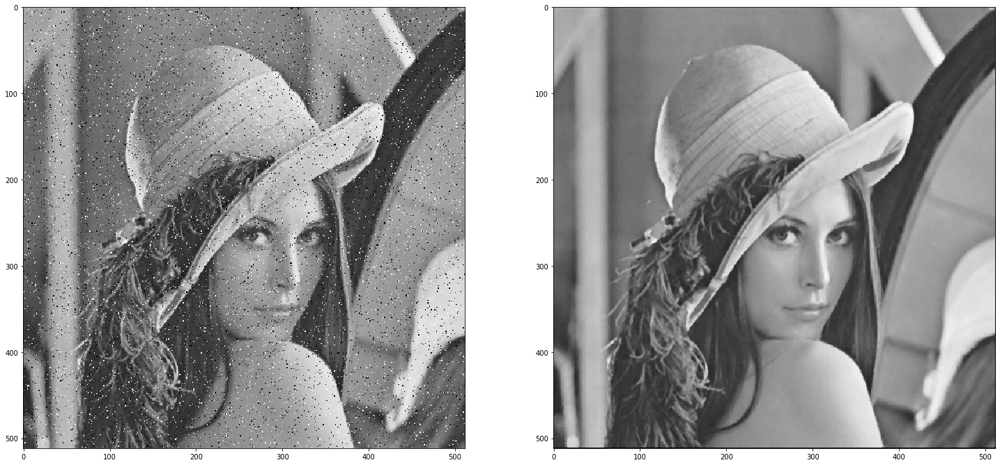

In [36]:
plt.figure(figsize = [25,25])
plt.subplot(121)
plt.imshow(splena,'gray')
plt.subplot(122)
plt.imshow(outputlena,'gray')

In [37]:
maxk = 12
time_out_medfilt = np.zeros(np.arange(2,maxk).shape)
input_im = splena.astype('uint8')

for i in range(2,maxk):
    ksize = i
    start_medfilt = time()
    out_medfilt = medfiltwrap(input_im,ksize)
    time_out_medfilt[i-2] = (time()-start_medfilt)

In [38]:
maxk = 12
time_out_opt = np.zeros(np.arange(2,maxk).shape)
input_im = splena.astype('uint8')

for i in range(2,maxk):
    ksize = i
    start_opt = time()
    out_opt = optmedfiltwrap(input_im, ksize)
    time_out_opt[i-2] = (time()-start_opt)
    

[ 8.77893376  8.50437236  8.16111469  8.19334531  8.24917436  8.51597953
  8.63801599 38.89195752  9.79587603  8.90855598]
[4.02263546 4.25836134 4.48941827 4.77738404 4.89976549 5.12781882
 5.37697864 5.60137081 5.80203319 6.05902433]


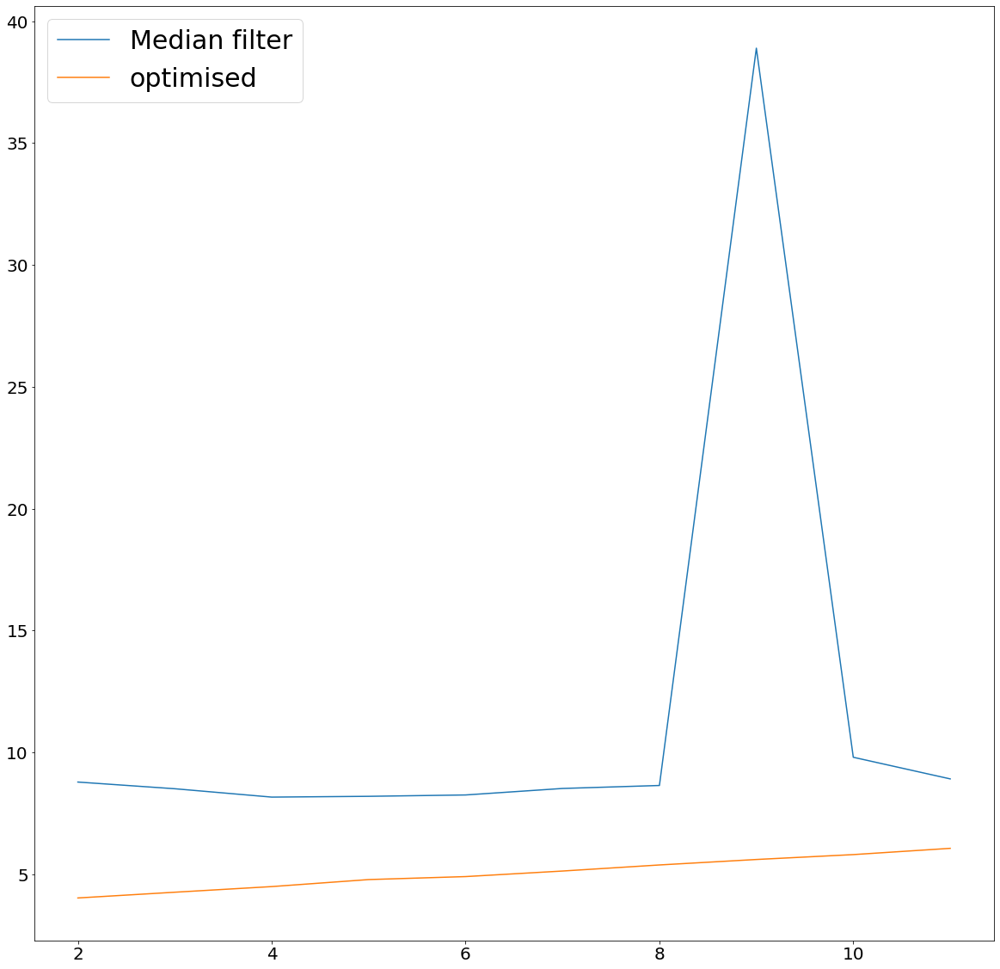

In [39]:
print(time_out_medfilt)
print(time_out_opt)
fig = plt.figure(figsize=[20,20])
ax= fig.add_subplot(111)
ax.tick_params(axis='both', which='major', labelsize=20)
ax.tick_params(axis='both', which='minor', labelsize=50)
ax.plot(range(2,maxk,1),time_out_medfilt,label = 'Median filter')
ax.plot(range(2,maxk,1),time_out_opt, label = 'optimised')
ax.legend(prop={'size': 30})

## Question 6

*Bilateral Filtering*

**Part - 1** *Implement bilateral filter and apply it to sky.png and noir.png.*

In [40]:
def bilfilt(image, smooth1, smooth2,ksize):
    '''
    '''
    vard = smooth1
    varr = smooth2
    if (len(image.shape)==2):
        pad_im = np.zeros([image.shape[0]+ksize,image.shape[1]+ksize])
        pad_im[0:image.shape[0],0:image.shape[1]] = image
        output = np.zeros(image.shape)
        dom = np.zeros([ksize,ksize])
        for i in range(0, ksize,1):
            for j in range(0, ksize,1):
                dom[i,j] = (exp(-((i-(ksize//2))**2 + (j-(ksize//2))**2)/(2*vard))/(2*pi*np.sqrt(vard)))
                
        for i in range(0, image.shape[0],1):
            for j in range(0, image.shape[1],1):
                denom = 0
                for k in range(i,i+ksize):
                    for l in range(j, j+ksize):
                        ran = (exp(-((pad_im[i,j] - pad_im[k,l])**2)/(2*varr))/(2*pi*np.sqrt(varr)))
                        weight = dom[k-i,l-j]*ran
                        output[i,j]+=pad_im[k,l]*weight
                        denom += weight
                output[i,j]=output[i,j]/denom
        return output

In [41]:
def bilfilt_wrap(image, sigma1, sigma2, ksize = 3):
    output=np.zeros(image.shape)
    if (len(image.shape)==2):
        output = bilfilt(image, sigma1, sigma2, ksize)
    elif (len(image.shape)==3):
        output[:,:,0] = bilfilt(image[:,:,0],sigma1,sigma2,ksize)
        output[:,:,1] = bilfilt(image[:,:,1],sigma1,sigma2,ksize)
        output[:,:,2] = bilfilt(image[:,:,2],sigma1,sigma2,ksize)
        
    return output

In [42]:
output_sky_bil=bilfilt_wrap(sky, 0.7,1.2,5)
output_noir_bil=bilfilt_wrap(noir, 0.7,1.2,5)

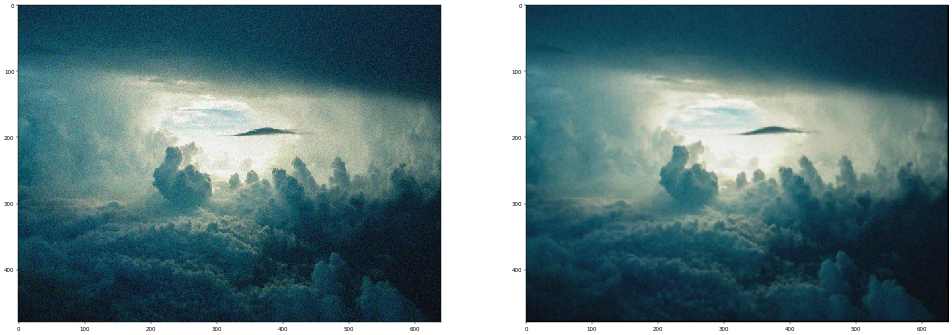

In [43]:
plt.figure(figsize=[30,30], dpi=40)
plt.subplot(121)
plt.imshow(sky)
plt.subplot(122)
plt.imshow(output_sky_bil)

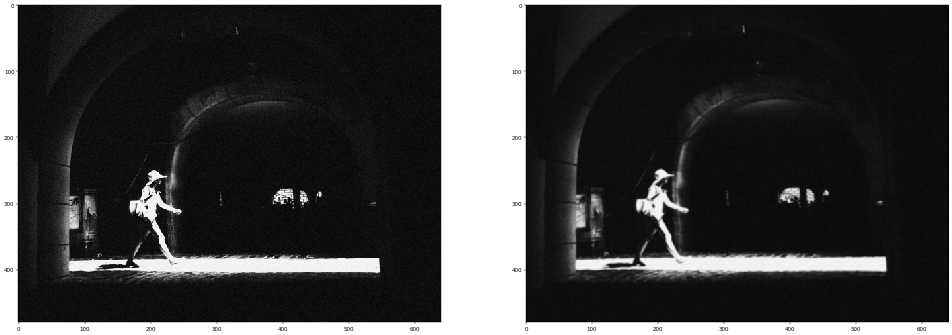

In [44]:
plt.figure(figsize=[30,30], dpi=40)
plt.subplot(121)
plt.imshow(noir)
plt.subplot(122)
plt.imshow(output_noir_bil)

In [45]:
dist = np.sqrt(np.sum(output_sky_bil - gtsky)**2)
print('dist(sky) = ',dist)
dist = np.sqrt(np.sum(output_noir_bil - gtnoir)**2)
print('dist(noir) = ',dist)

dist(sky) =  9800.877650066086
dist(noir) =  32806.578861917114


**Part - 2** *Vary the effect of domain and range components of the bilateral filter and try to
minimize the L2 distance from the ground truth images. Display the images and
the approximate values for the sigma.*

In [46]:
output_sky_bil1=bilfilt_wrap(sky, 10,14,3)

In [47]:
output_sky_bil2=bilfilt_wrap(sky, 8,1.2,5)

In [48]:
output_sky_bil3=bilfilt_wrap(sky, 4,3,7)

In [49]:
output_sky_bil4=bilfilt_wrap(sky, 0.1,1.2,3)

In [50]:
output_sky_bil5=bilfilt_wrap(sky, 50,30,9)

In [51]:
output_noir_bil1=bilfilt_wrap(noir, 10,14,3)

In [52]:
output_noir_bil2=bilfilt_wrap(noir, 8,1.2,5)

In [53]:
output_noir_bil3=bilfilt_wrap(noir, 4,3,7)

In [54]:
output_noir_bil4=bilfilt_wrap(noir, 0.1,1.2,3)

In [55]:
output_noir_bil5=bilfilt_wrap(noir, 50,30,4)

In [56]:
dist1 = np.sqrt(np.sum(output_sky_bil1 - gtsky)**2)
print('dist(sky) = ',dist1)
dist2 = np.sqrt(np.sum(output_sky_bil2 - gtsky)**2)
print('dist(sky) = ',dist2)
dist3 = np.sqrt(np.sum(output_sky_bil3 - gtsky)**2)
print('dist(sky) = ',dist3)
dist4 = np.sqrt(np.sum(output_sky_bil4 - gtsky)**2)
print('dist(sky) = ',dist4)
dist5 = np.sqrt(np.sum(output_sky_bil5 - gtsky)**2)
print('dist(sky) = ',dist5)

dist(sky) =  10504.87147594643
dist(sky) =  9806.22687712008
dist(sky) =  9090.311065494376
dist(sky) =  10505.104872864955
dist(sky) =  8371.20505406447


In [57]:
distb1 = np.sqrt(np.sum(output_noir_bil1 - gtsky)**2)
print('dist(noir) = ',distb1)
distb2 = np.sqrt(np.sum(output_noir_bil2 - gtsky)**2)
print('dist(noir) = ',distb2)
distb3 = np.sqrt(np.sum(output_noir_bil3 - gtsky)**2)
print('dist(noir) = ',distb3)
distb4 = np.sqrt(np.sum(output_noir_bil4 - gtsky)**2)
print('dist(noir) = ',distb4)
distb5 = np.sqrt(np.sum(output_noir_bil5 - gtsky)**2)
print('dist(noir) = ',distb5)

dist(noir) =  213258.4934353834
dist(noir) =  213486.4579567505
dist(noir) =  213689.93432206986
dist(noir) =  213258.266082956
dist(noir) =  213363.27427527867


Text(0.5, 1.0, 'Kernel size = 9, sigma1 = 50, sigma2 =30 \n Error = 8371.205054')

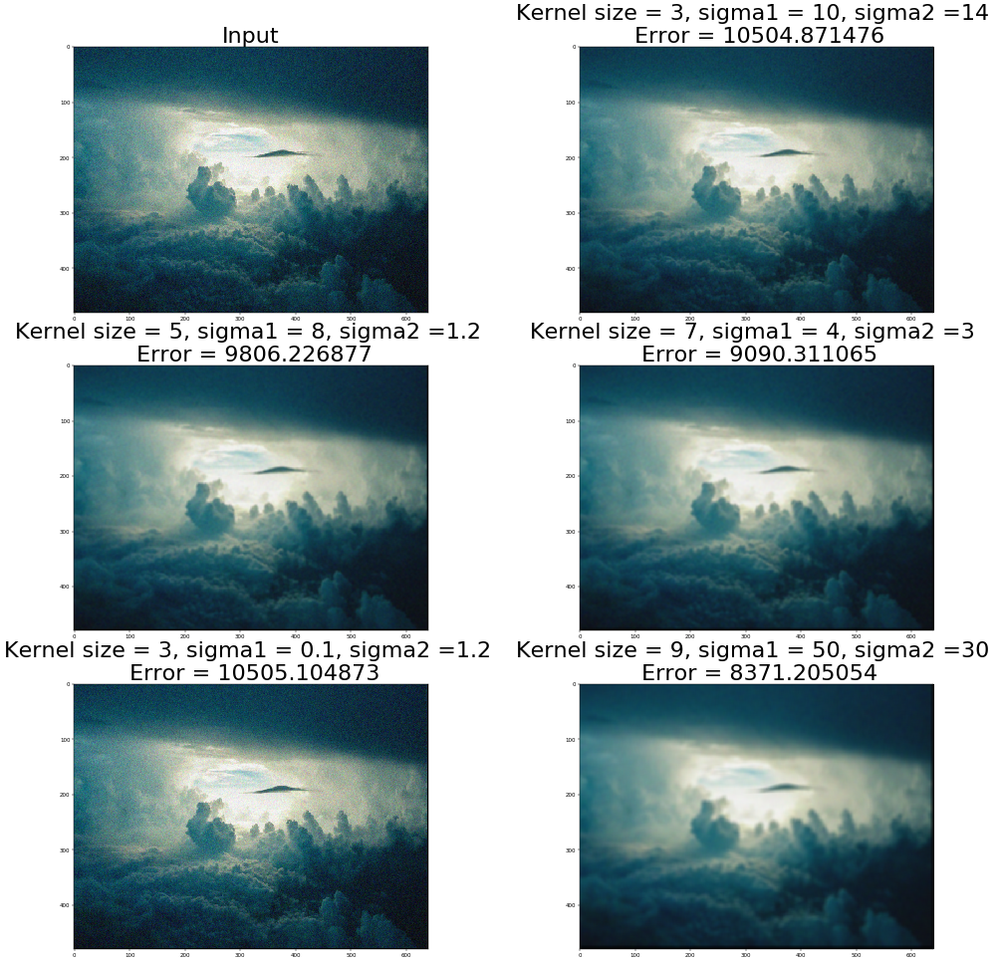

In [58]:
plt.figure(figsize=[30,30], dpi=40)
plt.subplot(321)
plt.imshow(sky)
plt.title('Input', fontsize = 40)
plt.subplot(322)
plt.imshow(output_sky_bil1)
plt.title('Kernel size = 3, sigma1 = 10, sigma2 =14 \n Error = %f'%dist1, fontsize = 40)
plt.subplot(323)
plt.imshow(output_sky_bil2)
plt.title('Kernel size = 5, sigma1 = 8, sigma2 =1.2 \n Error = %f'%dist2, fontsize = 40)
plt.subplot(324)
plt.imshow(output_sky_bil3)
plt.title('Kernel size = 7, sigma1 = 4, sigma2 =3 \n Error = %f'%dist3, fontsize = 40)
plt.subplot(325)
plt.imshow(output_sky_bil4)
plt.title('Kernel size = 3, sigma1 = 0.1, sigma2 =1.2 \n Error = %f'%dist4, fontsize = 40)
plt.subplot(326)
plt.imshow(output_sky_bil5)
plt.title('Kernel size = 9, sigma1 = 50, sigma2 =30 \n Error = %f'%dist5, fontsize = 40)

Text(0.5, 1.0, 'Kernel size = 4, sigma1 = 50, sigma2 =30 \n Error = 213363.274275')

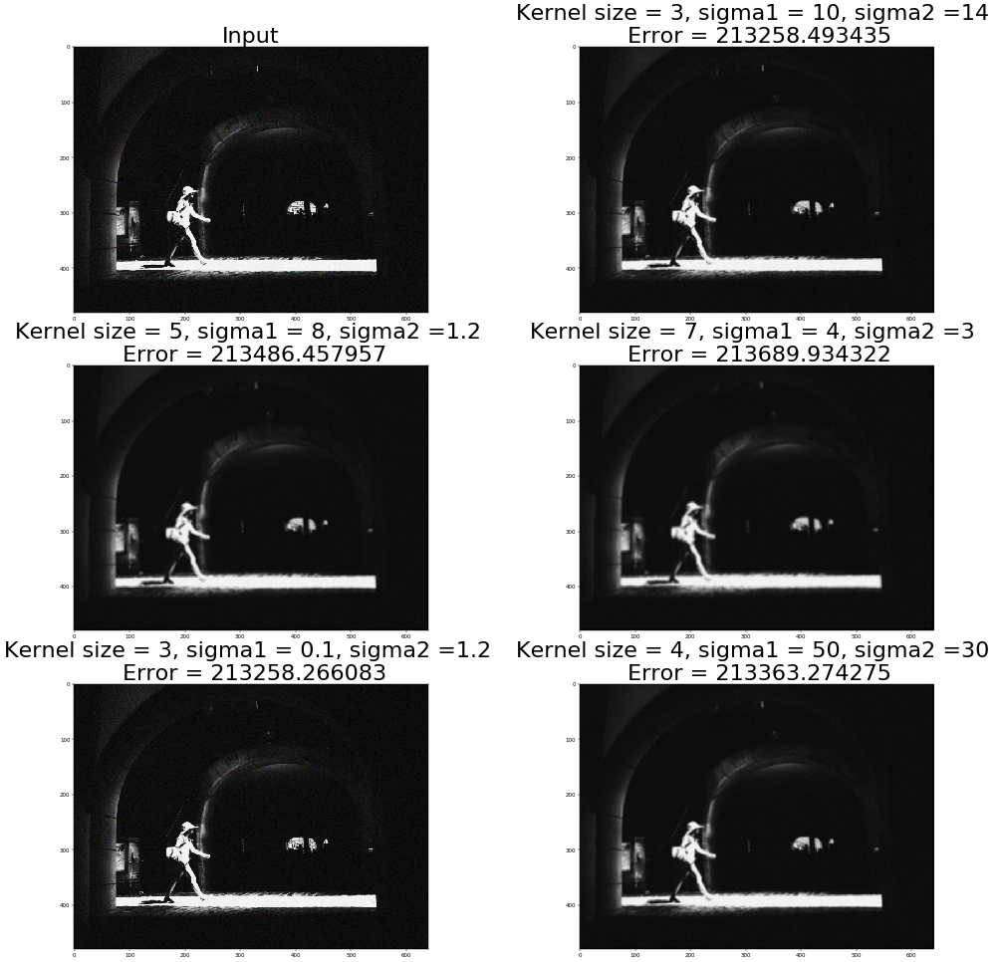

In [59]:
plt.figure(figsize=[30,30], dpi=40)
plt.subplot(321)
plt.imshow(noir)
plt.title('Input', fontsize = 40)
plt.subplot(322)
plt.imshow(output_noir_bil1)
plt.title('Kernel size = 3, sigma1 = 10, sigma2 =14 \n Error = %f'%distb1, fontsize = 40)
plt.subplot(323)
plt.imshow(output_noir_bil2)
plt.title('Kernel size = 5, sigma1 = 8, sigma2 =1.2 \n Error = %f'%distb2, fontsize = 40)
plt.subplot(324)
plt.imshow(output_noir_bil3)
plt.title('Kernel size = 7, sigma1 = 4, sigma2 =3 \n Error = %f'%distb3, fontsize = 40)
plt.subplot(325)
plt.imshow(output_noir_bil4)
plt.title('Kernel size = 3, sigma1 = 0.1, sigma2 =1.2 \n Error = %f'%distb4, fontsize = 40)
plt.subplot(326)
plt.imshow(output_noir_bil5)
plt.title('Kernel size = 4, sigma1 = 50, sigma2 =30 \n Error = %f'%distb5, fontsize = 40)

## Question 7

**Part - 1** *Cross Bilateral Filter : In low light imaging, images tend to be noisy and loose
sharp edges. However, with flash, there is an unpleasing direct-lighting effect.
Thus a cross bilateral filter can be used with the range and spatial filters acting on
two different images. Use a cross bilateral filter on the images pots flash.jpg and
pots no flash.jpg to produce the output and report the parameters?*

In [4]:
def jbilfilt(image1, image2, smooth1, smooth2, ksize):
    '''
    '''
    vard = smooth1
    varr = smooth2
    if (len(image1.shape)==2):
        pad_im1 = np.zeros([image1.shape[0]+ksize,image1.shape[1]+ksize])
        pad_im1[0:image1.shape[0],0:image1.shape[1]] = image1
        pad_im2 = np.zeros([image2.shape[0]+ksize,image2.shape[1]+ksize])
        pad_im2[0:image2.shape[0],0:image2.shape[1]] = image2
        output = np.zeros(image1.shape)
        dom = np.zeros([ksize,ksize])
        for i in range(0, ksize,1):
            for j in range(0, ksize,1):
                dom[i,j] = (exp(-((i-(ksize//2))**2 + (j-(ksize//2))**2)/(2*vard))/(2*pi*np.sqrt(vard)))
                
        for i in range(0, image1.shape[0],1):
            for j in range(0, image1.shape[1],1):
                denom = 0
                for k in range(i,i+ksize):
                    for l in range(j, j+ksize):
                        ran = (exp(-((pad_im1[i,j] - pad_im1[k,l])**2)/(2*varr))/(2*pi*np.sqrt(varr)))
                        weight = dom[k-i,l-j]*ran
                        output[i,j]+=pad_im2[k,l]*weight
                        denom += weight
                output[i,j]=output[i,j]/denom
        return output

In [5]:
def jointbilfilt_wrap(image1, image2, sigma1, sigma2, ksize = 3):
    image1 = image1/np.amax(image1)
    output=np.zeros(image1.shape)
    if (len(image1.shape)==2):
        output = jbilfilt(image1, image2, sigma1, sigma2, ksize)
    elif (len(image1.shape)==3):
        output[:,:,0] = jbilfilt(image1[:,:,0]/np.amax(image1[:,:,0]), image2[:,:,0]/np.amax(image2[:,:,0]), sigma1,sigma2,ksize)
        output[:,:,1] = jbilfilt(image1[:,:,1]/np.amax(image1[:,:,1]), image2[:,:,1]/np.amax(image2[:,:,1]), sigma1,sigma2,ksize)
        output[:,:,2] = jbilfilt(image1[:,:,2]/np.amax(image1[:,:,2]), image2[:,:,2]/np.amax(image2[:,:,2]), sigma1,sigma2,ksize)
        
    return output

In [6]:
output_jbil = jointbilfilt_wrap(potsflash, potsnoflash, 0.02, 50, 5)

Text(0.5, 1.0, 'Output')

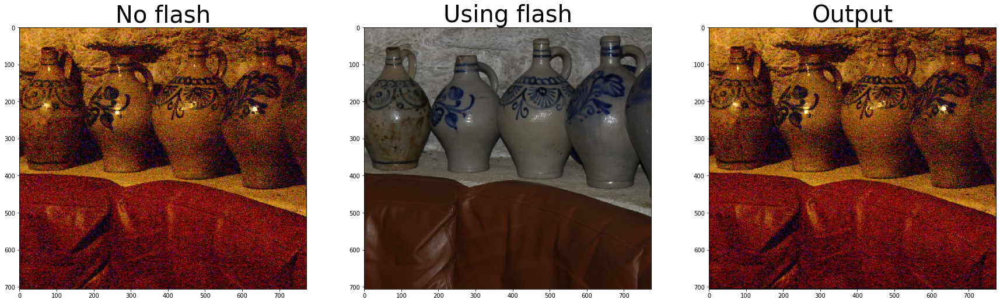

In [7]:
plt.figure(figsize = [30,30])
plt.subplot(131)
plt.title('No flash',fontsize = 40)
plt.imshow(potsnoflash)
plt.subplot(132)
plt.imshow(potsflash)
plt.title('Using flash',fontsize = 40)
plt.subplot(133)
plt.imshow(output_jbil)
plt.title('Output',fontsize = 40)

**Part - 2** *Inverse Bilateral Filter : Does it makes sense to develop an inverse bilateral
filter, which blurs an image at edges and preserves the homogeneous regions. If it
makes sense, design it and suggest its applications*

In [64]:
def invbilfilt(image, smooth1, smooth2,ksize):
    '''
    '''
    vard = smooth1
    varr = smooth2
    pad = (ksize)//2
#     pad = 0
    if (len(image.shape)==2):
        pad_im = np.zeros([image.shape[0]+ksize,image.shape[1]+ksize])
        pad_im[pad:pad+image.shape[0],pad:pad+image.shape[1]] = image
        output = np.zeros(image.shape)
        for i in range(pad, pad+image.shape[0],1):
            for j in range(pad, pad+image.shape[1],1):
                denom = 0
                for k in range(i-pad,i+pad+1):
                    for l in range(j-pad, j+pad+1):
                        weight = exp(-((i-k)**2 + (j-l)**2)/(2*vard) -((1-(pad_im[i,j] - pad_im[k,l])**2))/(2*varr))
                        output[i-pad,j-pad]+=pad_im[k,l]*weight
                        denom += weight
                output[i-pad,j-pad]=output[i-pad,j-pad]/denom
        return output
    elif(len(image.shape)==3):
        pass

In [65]:
def invbilfilt_wrap(image, sigma1, sigma2, ksize = 3):
    output=np.zeros(image.shape)
    if (len(image.shape)==2):
        output = invbilfilt(image-np.amin(image)/np.amax(image), sigma1, sigma2, ksize)
    elif (len(image.shape)==3):
        output[:,:,0] = invbilfilt((image[:,:,0]-np.amin(image[:,:,0]))/np.amax(image[:,:,0]),sigma1,sigma2,ksize)
        output[:,:,1] = invbilfilt((image[:,:,1]-np.amin(image[:,:,1]))/np.amax(image[:,:,1]),sigma1,sigma2,ksize)
        output[:,:,2] = invbilfilt((image[:,:,2]-np.amin(image[:,:,2]))/np.amax(image[:,:,2]),sigma1,sigma2,ksize)
        
    return output

In [66]:
output_inv = invbilfilt_wrap(bell,50,50,3)

Text(0.5, 1.0, 'Output')

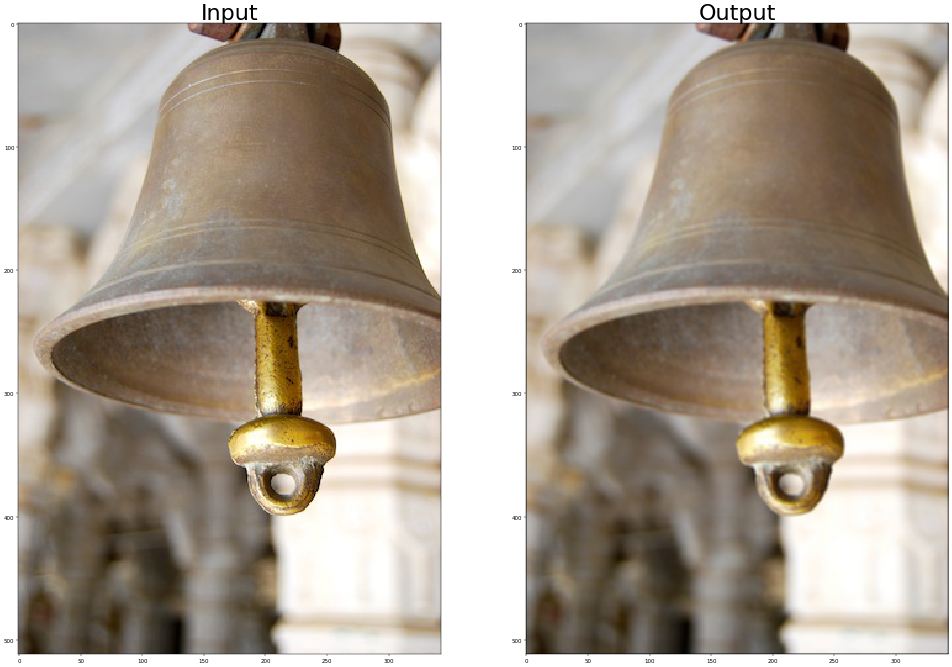

In [67]:
plt.figure(figsize=[30,30], dpi=40)
plt.subplot(121)
plt.imshow(bell)
plt.title('Input',fontsize=40)
plt.subplot(122)
plt.imshow(output_inv)
plt.title('Output',fontsize=40)

* Yes it does make sense to develop an inverse bilateral filter where image edges are suppressed and remaining content is preserved
> **Application of Inverse Bilateral filter** :-
Visual target detection is an important feature in-born in human, though for a computer it is challenging. We want to develop a system that segments the most visual object in an image which is robust to other sharp or blurred regions of the image.The major obstacle for the system is the vast range of content and
volatility of image properties. The scenes are captured under many different circumstances inducing considerable dissimilarity in texture. Therefore we can target contrast and opposition analysis by two steps to getting visual saliency high level. A salient region is defined as homogeneous contrast level inside the region.
So we define a contrast function. Since it depends upon content at various spatial locations, we should use range kernel of bilateral filter. Since `||f(i,j)-f(k,l)||` is a similarity metric we define a contrast metric as `1 - ||f(i,j)-f(k,l)||` and use it in standard bilateral filter. The result is seen above

## Question 8

*The image Degraded.jpg has been degraded in some way. Try to find out what kind
of degradation has been applied on the image and try to restore it. The original image
before degradation is Clean.jpg. Clearly explain what you did to restore the image.*

In [68]:
output_clean = medfiltwrap(degraded)

Text(0.5, 1.0, 'Ground Truth')

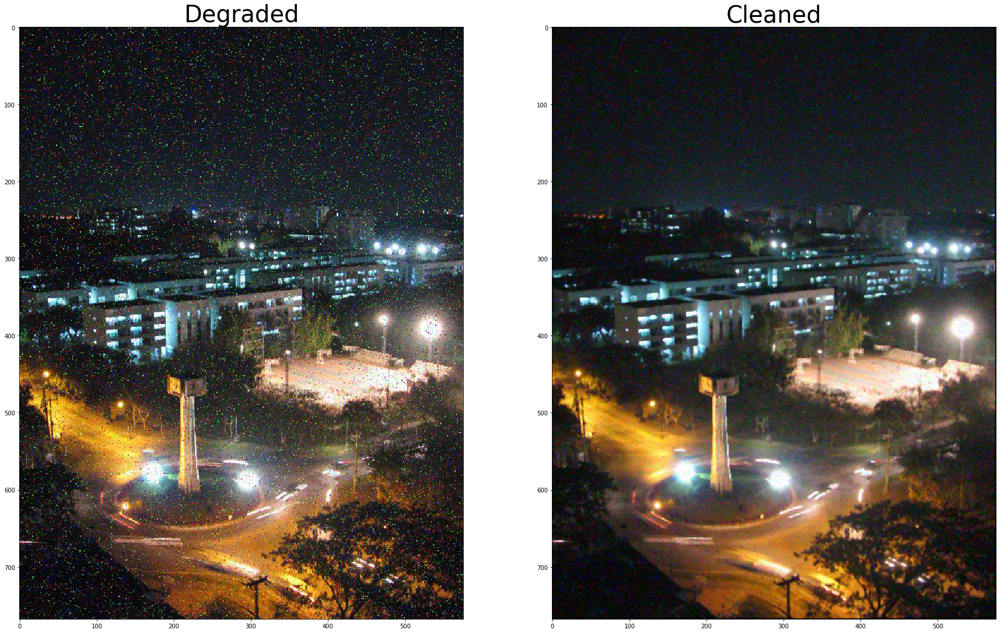

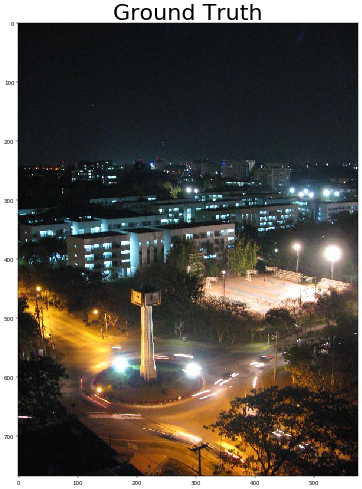

In [70]:
# print(output)
plt.figure(figsize = [30,30])
plt.subplot(121)
plt.imshow(degraded)
plt.title('Degraded',fontsize=40)
plt.subplot(122)
plt.imshow(output_clean)
plt.title('Cleaned',fontsize=40)
plt.figure(figsize = [15,15],dpi = 40)
plt.imshow(clear)
plt.title('Ground Truth',fontsize=40)

### Method used for cleaning degraded image :-

>Here median filtering is used because if image is observed closely, we can see salt and pepper noise in the image and the best solution for that which is computationally inexpensive is median filtering.

> A better computationally expensive solution is bilateral filtering which can be applied after median filtering to remove some finer noise elements that can be seen in the sky region